### Universidade Federal de Viçosa - Campus Viçosa

**Aluno:** Erick Lima Figueiredo | **Matricula:** 98898

**Professor:** Hugo Neves de Oliveira | **Disciplina:** Estrutura de Dados e Algoritmos (INF 610)

Link Colab: https://drive.google.com/file/d/1V_QjuAnssGj1J841yd1PTj5oqUQcfRiC/view?usp=sharing

---

##### Contextualização do Problema:

O problema de compressão de imagens é crucial em diversas áreas da computação,
incluindo armazenamento de dados, transmissão de imagens em redes de comunicação e otimização de recursos em dispositivos móveis. Com o volume crescente de dados visuais gerados e compartilhados diariamente, a eficiência na compressão de imagens impacta diretamente a qualidade e a velocidade de transmissão, além de reduzir os custos de armazenamento. Em contextos de inteligência artificial, a compressão eficiente de imagens é essencial para a transmissão rápida de dados visuais, processamento em tempo real e treinamento de modelos com grandes volumes de dados.

##### Justificativa:

As técnicas de compressão são parte do meu interesse particular que acabei não
trabalhando durante minha graduação. Apesar de esse não ser um tema diretamente
relacionado à minha proposta de pesquisa de mestrado (Modelos Generativos de Imagem), a compressão de imagens tem implicações diretas no campo da inteligência artificial, especialmente em aplicações que envolvem visão computacional, onde a qualidade e a rapidez no processamento das imagens são fundamentais.

##### Abordagem:

Para abordar o problema da compressão de imagens, propõe-se o estudo e a
implementação da estrutura de dados QuadTree, que por sua vez, é uma estrutura de dados hierárquica que divide uma imagem em regiões de forma adaptativa, baseando-se na uniformidade dos pixels. Essa abordagem tem o potencial de oferecer uma compressão mais eficiente em termos de qualidade e tamanho do arquivo, especialmente para imagens com grandes áreas de cor uniforme. Além da implementação dessa estrutura, serão comparadas técnicas mais ingênuas de compressão, como a utilização de blocos retangulares de tamanho fixo. A comparação, sugerida pelo professor ministrante da matéria, busca demonstrar as vantagens e desvantagens de cada método, bem como identificar cenários específicos onde uma técnica pode ser mais eficaz do que a outra.

_Disclaimer:_ Após conversas com o professor, conclui que a implementação de blocos fixos já seria suportada pela minha implementação de QuadTree, por conta disso, a comparação com uma implementação de QuadTree foi substituída pela implementação do algoritmo de Huffman que será aplicado na saída da compressão das imagens processadas na QuadTree.

---
#### Pseudo-Códigos & Análise de Complexidade

Abaixo são analisadas as complexidades dos principais métodos das estruturas de dados abordadas neste trabalho.

##### Binary Heap


```python

push(list data, int value) {
    # Principal operação: Inserção e movimentação do elemento para manter a propriedade do heap.
    # Complexidade: O(log n), onde n é o número de elementos no heap.  
    data.push(value)
    
    index = data.size() - 1
    parent_index = floor((index - 1) / 2)
    
    while (index > 0 and data[index] < data[parent_index]) do:
        swap(data[index], data[parent_index])
        
        index = parent_index
        parent_index = floor((index - 1) / 2)
}

heapify(list data, int parent) {
    # Principal operação: Movimentar o elemento para manter a propriedade do heap (chamada recursiva).
    # Complexidade: O(log n), onde n é o número de elementos no heap.
    top = parent

    l = 2 * parent + 1
    r = 2 * parent + 2

    if (l < data.size() and data[l] < data[top]) then:
        top = l

    if (r < data.size() and data[r] < data[top]) then:
        top = r

    if (top != parent) then:
        data[top], data[parent]
        heapify(top)
}


pop(list data) {
    # Principal operação: Chamada do heapify para manter a propriedade do heap.
    # Complexidade: O(log n), onde n é o número de elementos no heap.
    if (data.empty()) then:
        return
        
    value = data[0]
    data[0] = data[data.size()-1]
    data.pop(-1)
    
    heapify(0)
    
    return value
}


bottom_up_heapify(list data) {
    # Principal operação: Aplicar heapify de baixo para cima para construir o heap.
    # Complexidade: O(n log n), onde n é o número de elementos no heap.
    if (data.size() <= 1) then:
        return

    index = data.size() - 1

    for (i from  floor(index / 2) to 0 step -1) do:
        heapify(i)
}
```

##### Huffman Encoding

```python
get_char_frequency(string content) {
    # Principal operação: Iterar sobre cada caractere da string e atualizar a contagem de frequência.
    # Complexidade: O(n), onde n é o comprimento da string.
    char_frequency = {}
    
    for (c in content) do:
        if (not char_frequency.find(c)) then:
            char_frequency[c] = 1
        else:
            char_frequency[c] = char_frequency[c] + 1
            
    return char_frequency
}

build_tree(string content) {
    # Principal operação: Construção de uma árvore de Huffman usando um heap binário.
    # Complexidade: O(n log n), onde n é o número de caracteres distintos na string.
    free_by_char = get_char_frequency(content)
    
    nodes = []
    for (key, value in free_by_char) do:
        nodes.push(HuffNode(key, value))
    
    heap = BinaryHeap(nodes)
    
    while (heap.size()) > 1 do:
        node1 = h.pop()
        node2 = h.pop()

        merged = HuffNode(None, node1.freq +
                            node2.freq if node2 else node1.freq)
        merged.left = node1
        merged.right = node2
        h.push(merged)
        
    return heap.pop()
}

build_codes(HuffNode node, string prefix, dict code) {
    # Principal operação: Percorrer a árvore de Huffman recursivamente e gerar os códigos.
    # Complexidade: O(n), onde n é o número de nós na árvore.
    if (code == null) then:
        code = {}

    if (node != null) then:
        if (node.char != null) then:
            code[node.char] = prefix

        build_codes(node.left, prefix + '0', code)
        build_codes(node.right, prefix + '1', code)

    return code
}

encode(string text) {
    # Principal operação: Construir a árvore de Huffman e gerar a codificação do texto.
    # Complexidade: O(n log n) para construir a árvore e O(n) para codificar o texto, resultando em O(n log n) no geral.
    root = build_tree(text)
    code = build_codes(root)

    result = ''

    for (char in text) do:
        result = result + code[char]
    
    return result
}

decode (string encoded_text, HuffNode node) {
    # Principal operação: Percorrer a árvore de Huffman para decodificar o texto.
    # Complexidade: O(n), onde n é o comprimento do texto codificado.
    decoded_text = []
    node = root

    for (bit in encoded_text) do:
        if (bit == '0') then:
            node = node.left
        else:
            node = node.right

        if (node.char != null) then:
            decoded_text.push(node.char)
            node = root

    result = ''
    for (char in decoded_text) do:
        result = result + char
    
    return result
}
```

##### QuadTree


```python
get_children(Quadrant quad) {
    # Principal operação: Recursivamente coletar todos os filhos do quadrante.
    # Complexidade: O(n), onde n é o número total de quadrantes.
    if (quad.children.is_empty()) then:
        return [quad]

    children = []
    for (child in quad.children) do:
        children.extend(get_children(child))

    return children
}

get_compressed_image(Quadrant root, list[list[list]] image) {
    # Principal operação: Iterar sobre todos os quadrantes e calcular a cor média de cada um.
    # Complexidade: O(n * c * h * w), onde n é o número de quadrantes, c é o número de canais de cor, h e w são as dimensões dos quadrantes.
    compressed_image = [][][]
    children = get_children(root)

    for (child in children) do:
        quadrant = child.get_quadrant_from_image(child.x, child.y, child.height, child.width, 3, image)

        for (i from y to y+height) do:
            quadrant.push([])
            for (j from x to x+width) do:              
                quadrant[i][j] = child.calc_mean_color(quadrant)

    return compressed_image
}

build_tree(float threshold, int min_quad_size, Quadrant quad) {
    # Principal operação: Recursivamente dividir o quadrante em subquadrantes até que a condição de parada seja satisfeita.
    # Complexidade: O(n), onde n é o número total de quadrantes.
    if (threshold and calc_error(image) <= threshold) then:
        return

    bottom_width = floor(quadrant.width / 2)
    top_width = ceil(quadrant.width / 2)
    bottom_height = floor(quadrant.height / 2)
    top_height = ceil(quadrant.height / 2)

    if (bottom_width < 1 or bottom_height < 1) then:
        return

    if (min_quad_size and (bottom_width <= min_quad_size or bottom_height <= min_quad_size)) then:
        return

    top_left = Quadrant(quad.x, quad.y, bottom_width, bottom_height, quadrant.depth + 1)
    build_tree(threshold, min_quad_size, top_left)

    top_right = Quadrant(quadrant.x + bottom_width, quadrant.y, top_width, bottom_height, quadrant.depth + 1)
    build_tree(threshold, min_quad_size, top_right)

    bottom_left = Quadrant(quadrant.x, quadrant.y + bottom_height, bottom_width, top_height, quadrant.depth + 1)
    build_tree(threshold, min_quad_size, bottom_left)

    bottom_right = Quadrant(quadrant.x + bottom_width, quadrant.y + bottom_height, top_width, top_height, quadrant.depth + 1)
    build_tree(threshold, min_quad_size, bottom_right)

    quadrant.children = [top_left, top_right, bottom_left, bottom_right]
}

calc_error(list[list[list]] image) {
    # Principal operação: Calcular o erro médio quadrático entre a cor média e as cores dos pixels.
    # Complexidade: O(h * w * c), onde h e w são as dimensões do quadrante e c é o número de canais de cor.
    quadrant = get_quadrant_from_image(image)
    mean_color = calc_mean_color(quadrant)

    height, width, channels = quadrant.shape

    sum_squared_diff = 0
    total_pixels = height * width

    for (i from 0 to height) do:
        for (j from 0 to width) do:
            for (c from 0 to channels) do:
                diff = quadrant[i][j][c] - mean_color[c]
                sum_squared_diff = sum_squared_diff + diff ** 2

    mean_squared_diff = sum_squared_diff / total_pixels
    error = mean_squared_diff ^ 0.5

    return error
}

calc_mean_color(list[list] quadrant) {
    # Principal operação: Calcular a cor média dos pixels no quadrante.
    # Complexidade: O(h * w * c), onde h e w são as dimensões do quadrante e c é o número de canais de cor.
    height, width, channels = quadrant.shape
    total_pixels = height * width
    sum_color = [0] * channels

    for (i from 0 to height) do:
        for (j from 0 to width) do:
            for (c from 0 to channels) do :
                sum_color[c] = sum_color[c] + quadrant[i][j][c]

    color = []
    for (c from 0 to channels) do :
        color.push(floor(sum_color[c] / total_pixels))

    return color
}

get_quadrant_from_image(int x, int y, int height, int width, int channel, list[list[list]] image) {
    # Principal operação: Extrair um subquadrante da imagem.
    # Complexidade: O(h * w * c), onde h e w são as dimensões do subquadrante e c é o número de canais de cor.
    quadrant = [][][]

    for (i from y to y+height) do:
        quadrant.push([])
        for (j from x to x+width) do:
            quadrant[i].push([])
            for (k from 0 to channel) do:
                quadrant[i][j].push(image[i][j][k])

    return quadrant
}

get_max_depth(Quadrant quad) {
    # Principal operação: Recursivamente determinar a profundidade máxima da árvore de quadrantes.
    # Complexidade: O(n), onde n é o número total de quadrantes.
    if (quad.children.is_empty()) then:
        return quad.depth

    max_depth = 0
    for (child in quad.children) do:
        max_depth = max(max_depth, get_max_depth(child))

    return max_depth
}
```


#### Importação de Bibliotecas

In [ ]:
import os
import cv2
import numpy as np
import pandas as pd
import seaborn as sns
from copy import deepcopy
import matplotlib.pyplot as plt
import matplotlib.image as mpimg


#### Algoritmo de Huffman

A codificação de Huffman é um algoritmo de compressão desenvolvido em $1952$ por David Albert Huffman, que usa da contabilização de ocorrência de símbolos em uma dada _string_ para o estabelecimento de prefixos ótimos e não ambíguos. Trata-se de um algoritmo de compressão de dados sem perda que busca atribuir prefixos mais curtos a caracteres mais frequentes e longos aquelas com menor frequência. Esse processo se dá por meio do paradigma __Guloso__, que é útil quando o problema envolve a realização de escolhas que são localmente ótimas. O algoritmo é útil no processo de compactação de textos, áudios, imagens e outros, pois é capaz de reduzir de forma significativa seu tamanho sem a perda de informação.

Referências:

https://brilliant.org/wiki/huffman-encoding/

https://compression.ru/download/articles/huff/huffman_1952_minimum-redundancy-codes.pdf

https://en.wikipedia.org/wiki/Huffman_coding#cite_note-1

https://medium.com/@malizamankhan/huffman-coding-algorithm-efficient-data-structure-compression-3e634b38a830

##### Binary Heap

In [ ]:
# Implementação Reaproveitada de Atividades Complementares Anteriores

class BinaryHeap:
    """
    A class to represent a binary heap.
    """

    def __init__(self, data: list[any] = [], criteria: callable = (lambda a, b: a < b)) -> None:
        """
        Constructor for the BinaryHeap class.
        :param data: Initial list of elements to build the heap.
        :param criteria: Comparison function to establish heap order.
        """
        self.__data = deepcopy(data)
        self.__criteria = criteria
        self.__bottom_up_heapify()

    def get_heap(self) -> list[any]:
        """
        Getter for the heap.
        :return: A deep copy of the heap data.
        """
        return deepcopy(self.__data)

    def push(self, value: any) -> None:
        """
        Method to insert a new value into the heap.
        :param value: The value to be added to the heap.
        """
        self.__data.append(value)
        index = len(self.__data) - 1
        parent_index = self.__get_parent_by_index(index)

        while index > 0 and self.__criteria(self.__data[index], self.__data[parent_index]):
            self.__data[index], self.__data[parent_index] = self.__data[parent_index], self.__data[index]
            index = parent_index
            parent_index = self.__get_parent_by_index(index)

    def pop(self) -> any:
        """
        Method to remove and return the root value of the heap.
        :return: The root value of the heap.
        """
        if not len(self.__data):
            return None

        value = self.__data[0]
        self.__data[0] = self.__data[-1]
        del self.__data[-1]
        self.heapify(0)
        return value

    def heapify(self, parent: int) -> None:
        """
        Method to maintain the heap property.
        :param parent: Index of the parent node.
        """
        top = parent

        l = 2 * parent + 1
        r = 2 * parent + 2

        if l < len(self.__data) and self.__criteria(self.__data[l], self.__data[top]):
            top = l

        if r < len(self.__data) and self.__criteria(self.__data[r], self.__data[top]):
            top = r

        if top != parent:
            self.__data[top], self.__data[parent] = self.__data[parent], self.__data[top]
            self.heapify(top)

    def __bottom_up_heapify(self) -> None:
        """
        Method to build the heap from an unordered list.
        """
        if len(self.__data) <= 1:
            return

        index = len(self.__data) - 1

        for i in range(index // 2, -1, -1):
            self.heapify(i)

    def __get_parent_by_index(self, index: int) -> int:
        """
        Method to get the parent index of a given node.
        :param index: Index of the child node.
        :return: Index of the parent node.
        """
        return (index - 1) // 2

    def __len__(self) -> int:
        """
        Method to get the number of elements in the heap.
        :return: Number of elements in the heap.
        """
        return len(self.__data)

##### HuffNode

In [ ]:
class HuffNode:
    """
    A class to represent a node in the Huffman tree.
    """

    def __init__(self, char: str, freq: int) -> None:
        """
        Constructor for the HuffNode class.
        :param char: Character represented by the node.
        :param freq: Frequency of the character.
        """
        self.char = char
        self.freq = freq

        self.left = None
        self.right = None

    def __lt__(self, other: 'HuffNode') -> bool:
        """
        Less-than comparison operator for HuffNode.
        :param other: Another HuffNode to compare with.
        :return: True if the frequency of this node is less than the other node, False otherwise.
        """
        return self.freq < other.freq

    def __str__(self) -> str:
        """
        String representation of the HuffNode class.
        :return: String representation of the HuffNode class.
        """
        return f'[char: {self.char}, freq: {self.freq}]'

##### Huffman

In [ ]:
class HuffmanEncoding:
    """
    A class to represent Huffman Encoding.
    """

    def __init__(self) -> None:
        """
        Constructor for the HuffmanEncoding class.
        """
        pass

    def get_char_frequency(self, content: str) -> dict:
        """
        Method to calculate the frequency of each character in the given content.
        :param content: The string content to analyze.
        :return: A dictionary with characters as keys and their frequencies as values.
        """
        char_frequency = {}

        for c in content:
            if c not in char_frequency:
                char_frequency[c] = 1
            else:
                char_frequency[c] += 1

        return char_frequency

    def build_tree(self, content: str) -> 'HuffNode':
        """
        Method to build the Huffman tree for the given content.
        :param content: The string content to build the tree for.
        :return: The root node of the Huffman tree.
        """
        freq_by_char = self.get_char_frequency(content=content)
        print('\t\tFrequence by char:', freq_by_char)

        nodes = [HuffNode(char=c, freq=f) for c, f in freq_by_char.items()]
        h = BinaryHeap(nodes, criteria=(lambda a, b: a < b))

        while len(h) > 1:
            node1 = h.pop()
            node2 = h.pop()

            merged = HuffNode(None, node1.freq +
                              node2.freq if node2 else node1.freq)
            merged.left = node1
            merged.right = node2
            h.push(merged)

        return h.pop()

    def build_codes(self, node: 'HuffNode', prefix: str = '', code: dict = None) -> dict:
        """
        Method to build the Huffman codes for characters.
        :param node: The current node in the Huffman tree.
        :param prefix: The current Huffman code prefix.
        :param code: The dictionary to store Huffman codes.
        :return: A dictionary with characters as keys and their Huffman codes as values.
        """
        if code is None:
            code = {}

        if node is not None:
            if node.char is not None:
                code[node.char] = prefix

            self.build_codes(node.left, prefix + '0', code)
            self.build_codes(node.right, prefix + '1', code)

        return code

    def __encode(self, text: str, code: dict) -> str:
        """
        Private method to encode the given text using the Huffman codes.
        :param text: The text to encode.
        :param code: The Huffman codes dictionary.
        :return: The encoded text as a string of bits.
        """
        return ''.join(code[char] for char in text)

    def __decode(self, encoded_text: str, root: 'HuffNode') -> str:
        """
        Private method to decode the given encoded text using the Huffman tree.
        :param encoded_text: The encoded text as a string of bits.
        :param root: The root of the Huffman tree.
        :return: The decoded text.
        """
        decoded_text = []
        node = root
        for bit in encoded_text:
            if bit == '0':
                node = node.left
            else:
                node = node.right

            if node.char is not None:
                decoded_text.append(node.char)
                node = root

        return ''.join(decoded_text)

    def encoding(self, text: str) -> tuple:
        """
        Method to encode the given text and return the encoded text and Huffman tree.
        :param text: The text to encode.
        :return: A tuple containing the encoded text and the root of the Huffman tree.
        """
        root = self.build_tree(text)
        code = self.build_codes(root)
        enc = self.__encode(text, code)
        return enc, root

    def decoding(self, encoded_text: str, root: 'HuffNode') -> str:
        """
        Method to decode the given encoded text using the Huffman tree.
        :param encoded_text: The encoded text as a string of bits.
        :param root: The root of the Huffman tree.
        :return: The decoded text.
        """
        return self.__decode(encoded_text, root)

#### Algoritmo QuadTree

A QuadTree é um tipo de estrutura de dados em árvore, inventada em $1974$ por R. Finkel e J. L. Bentley, onde cada nó possui exatamente quatro filhos de mesma dimensão. Essa estrutura de dados é frequentemente utilizada para particionar um espaço bidimensional, dividindo-o recursivamente em quatro quadrantes. Essa subdivisão se dá a partir da aceitação a certo critério e a informação armazenada nos nós pode variar de acordo com o objetivo desejado. O **paradigma de design de algoritmo** utilizado na construção da QuadTree é de **Divisão e Conquista**, uma vez que dividimos os quadrantes em quadrantes menores, e no caso do problema de compressão de imagem, essas subdivisões que agregam regiões similares por meio de um pixel médio serão, ao final, rearranjadas, formando a imagem comprimida. Dentre as principais aplicações das QuadTrees, podemos citar:

- Compressão de Imagem (foco desse trabalho): Podem ser usadas para comprimir imagens, aglutinando regiões de pixel similares, o que permite uma compressão mais "inteligente" reduzindo a perda de nitidez no resultado final.

- Detecção de Colisão:  Podem ser usadas no processo de detecção de colisão entre objetos em um jogo ou simulação, por exemplo, verificando se as bounding boxes dos objetos se intersectam.

- Serviços Baseados em Localização: Podem ser usadas para armazenar e consultar informação geospacial de forma eficiente, como encontrrar pontos dentro de um uma dada instância de um Ponto de Interesse (POI).



Referências:

https://cis.temple.edu/~lakaemper/courses/cis068_2006_2/assignments/assignment_08Tree.html

https://www.deepblock.net/blog/quadtree

https://en.wikipedia.org/wiki/Quadtree#Image_processing_using_quadtrees
https://www.geeksforgeeks.org/quad-tree/

https://medium.com/@tannerwyork/quadtrees-for-image-processing-302536c95c00

https://www.researchgate.net/publication/220197855_Quad_Trees_A_Data_Structure_for_Retrieval_on_Composite_Keys

##### Quadrant Node

In [ ]:
class QuadrantRepresentationError(Exception):
    """
    Exception to raise when the Quadrant color is not set.
    """
    pass


class Quadrant:
    """
    A class to represent a quadrant (Node) in a quadtree.
    """

    def __init__(self, x: int, y: int, width: int, height: int, depth: int = 0) -> None:
        """
        Constructor for the Quadrant class.
        :param x: origin X-coordinate of the quadrant in the quadtree.
        :param y: origin Y-coordinate of the quadrant in the quadtree.
        :param width: Width of the quadrant in the quadtree.
        :param height: Height of the quadrant in the quadtree.
        :param depth: Depth of the quadrant in the quadtree.
        """
        self.__origin = {'x': x, 'y': y}
        self.__width = width
        self.__height = height

        self.__depth = depth
        self.__children = []
        self.__color = None

    @property
    def origin(self) -> dict:
        """
        Getter for the origin of the quadrant.
        :return: Origin of the quadrant.
        """
        return deepcopy(self.__origin)

    @property
    def width(self) -> int:
        """
        Getter for the width of the quadrant.
        :return: Width of the quadrant.
        """
        return self.__width

    @property
    def height(self) -> int:
        """
        Getter for the height of the quadrant.
        :return: Height of the quadrant.
        """
        return self.__height

    @property
    def depth(self) -> int:
        """
        Getter for the depth of the quadrant.
        :return: Depth of the quadrant.
        """
        return self.__depth

    @property
    def children(self) -> list:
        """
        Getter for the children of the quadrant.
        :return: All children nodes of the quadrant.
        """
        return self.__children

    @children.setter
    def children(self, children: list) -> None:
        """
        Setter for the children of the quadrant.
        :param children: List of children quadrants.
        :return: None
        """
        self.__children = children

    def get_area(self) -> int:
        """
        Method to calculate the area of the quadrant.
        :return: Area of the quadrant.
        """
        return self.__width * self.__height

    def get_quadrant_from_image(self, image: np.ndarray) -> np.ndarray:
        """
        Method to get the quadrant from the image.
        :param image: Target image to extract the quadrant from.
        :return: Quadrant of the image.
        """
        return image[self.__origin['y']:self.__origin['y'] + self.__height,
                     self.__origin['x']:self.__origin['x'] + self.__width]

    def calc_error(self, image: np.ndarray) -> float:
        """
        Method to calculate the error of the quadrant.
        :param image: Target image to calculate the error from.
        :return: Error (std) of the quadrant considering the mean color.
        """
        quadrant = self.get_quadrant_from_image(image)
        mean_color = self.calc_mean_color(quadrant)

        return np.sqrt(np.mean((quadrant - mean_color) ** 2))

    def calc_mean_color(self, quadrant: np.ndarray) -> np.ndarray:
        """
        Method to calculate the mean color of the quadrant.
        :param quadrant: Target quadrant to calculate the mean color from.
        :return: Mean color of the quadrant.
        """
        if not self.__color:
            self.__color = [int(p) for p in np.mean(quadrant, axis=(0, 1))]

        return self.__color

    def __str__(self) -> str:
        """
        String representation of the Quadrant class.
        :return: String representation of the Quadrant class.
        """
        if not self.__color:
            raise QuadrantRepresentationError(
                "Quadrant color is not set. Please calculate the mean color first!")

        return f"{self.__origin['x']};{self.__origin['y']};{self.__origin['x'] + self.__width};{self.__origin['y'] + self.__height};{','.join(str(l) for l in self.__color)}"

##### QuadTree

In [ ]:
class QuadTree:
    """
    QuadTree class implementation for Image Compression.
    """

    def __init__(self, image: np.ndarray, threshold: int = None, min_quad_size: int = 1) -> None:
        """
        Constructor for the QuadTree class.
        :param image: Image to be compressed.
        :param threshold: Threshold value for quadrant split.
        :param min_quad_size: Minimum size of the quadrant.
        """
        self.__image = deepcopy(image)

        self.__threshold = threshold
        self.__min_quad_size = min_quad_size

        self.root = Quadrant(0, 0, image.shape[1], image.shape[0], 0)
        self.__build_tree(self.root)

    @property
    def max_depth(self) -> int:
        """
        Getter for the maximum depth of the quadtree.
        """
        return self.__get_max_depth(self.root)

    def get_children(self) -> list[Quadrant]:
        """
        Getter for the leaves of the quadtree.
        """
        return self.__get_children(self.root)

    def get_compressed_image(self, show_quadrants: bool = False, highlight_color: tuple = (0, 255, 0)) -> np.ndarray:
        """
        Method to get the compressed image from the quadtree.
        :param show_quadrants: Flag to show the quadrants highlighted in the compressed image.
        :param highlight_color: Color to highlight the quadrants.
        """
        compressed_image = np.zeros_like(self.__image)
        children = self.get_children()

        for child in children:
            quadrant = child.get_quadrant_from_image(self.__image)
            compressed_image[child.origin['y']:child.origin['y'] + child.height,
            child.origin['x']:child.origin['x'] + child.width, :] = child.calc_mean_color(quadrant)

        if show_quadrants:
            for child in children:
                cv2.rectangle(compressed_image, (child.origin['x'], child.origin['y']),
                                     (child.origin['x'] + child.width, child.origin['y'] + child.height),
                                     highlight_color, 1)

        return compressed_image

    def build_compressed_file(self, save_path: str = None, filename: str = None) -> None:
        """
        Method to build a compressed file from the quadtree. creates a file with ".lima" extension which contains the
        instructions for the compressed file construction.
        :param save_path: Path to save the compressed file.
        :param filename: Name of the compressed file.
        """
        if not (save_path and filename):
            raise ValueError('Please provide a save path and filename!')

        quadrants = self.get_children()
        compressed_data = '&'.join([str(quad) for quad in quadrants])

        compressed_data = f'{self.__image.shape[0]};{self.__image.shape[1]}&{compressed_data}'
        with open(os.path.join(save_path, f'{filename}.lima'), 'w') as file:
            file.write(compressed_data)

        return compressed_data

    @staticmethod
    def parse_compressed_file(file_path: str) -> np.ndarray:
        """
        Static Method to parse the compressed file and build the quadtree.
        :param file_path: Path to the compressed file.
        :return: Parsed image.
        """
        if not file_path.endswith('.lima'):
            raise ValueError('Invalid file extension!')

        with open(file_path, 'r') as file:
            data = file.read().split('&')

        shape = data[0].split(';')
        parsed_image = np.zeros((int(shape[0]), int(shape[1]), 3), dtype=np.uint8)

        for quad_data in data[1:]:
            quad = quad_data.split(';')
            color = [int(c) for c in quad[-1].split(',')]
            parsed_image[int(quad[1]):int(quad[3]), int(quad[0]):int(quad[2]), :] = color

        return parsed_image

    def __get_max_depth(self, quadrant: Quadrant) -> int:
        """
        Method to get the maximum depth of the quadtree recursively.
        :param quadrant: Quadrant to get the depth from.
        """
        if not quadrant.children:
            return quadrant.depth

        max_depth = 0
        for child in quadrant.children:
            max_depth = max(max_depth, self.__get_max_depth(child))

        return max_depth

    def __get_children(self, quadrant: Quadrant) -> list[Quadrant]:
        """
        Method to get the leaves of the quadtree recursively.
        :param quadrant: Quadrant to get the leaves from.
        """
        if not quadrant.children:
            return [quadrant]

        children = []
        for child in quadrant.children:
            children.extend(self.__get_children(child))

        return children

    def __build_tree(self, quadrant: Quadrant) -> None:
        """
        Method to build the quadtree recursively.
        :param quadrant: Quadrant to be split.
        """
        if self.__threshold and quadrant.calc_error(self.__image) <= self.__threshold:
            return

        bottom_width, top_width = np.floor(quadrant.width / 2).astype(int), np.ceil(quadrant.width / 2).astype(int)
        bottom_height, top_height = np.floor(quadrant.height / 2).astype(int), np.ceil(quadrant.height / 2).astype(int)

        if bottom_width < 1 or bottom_height < 1:
            return

        if self.__min_quad_size and (bottom_width <= self.__min_quad_size or bottom_height <= self.__min_quad_size):
            return

        top_left = Quadrant(quadrant.origin['x'], quadrant.origin['y'], bottom_width, bottom_height, quadrant.depth + 1)
        self.__build_tree(top_left)

        top_right = Quadrant(quadrant.origin['x'] + bottom_width, quadrant.origin['y'], top_width, bottom_height,
                             quadrant.depth + 1)
        self.__build_tree(top_right)

        bottom_left = Quadrant(quadrant.origin['x'], quadrant.origin['y'] + bottom_height, bottom_width, top_height,
                               quadrant.depth + 1)
        self.__build_tree(bottom_left)

        bottom_right = Quadrant(quadrant.origin['x'] + bottom_width, quadrant.origin['y'] + bottom_height, top_width,
                                top_height, quadrant.depth + 1)
        self.__build_tree(bottom_right)

        quadrant.children = [top_left, top_right, bottom_left, bottom_right]


#### Experimentação

In [ ]:
IMAGES_PATH = './reference'
COMPRESSED_IMAGES_PATH = './compressed'

In [ ]:
images_ref = {}

for img in os.listdir(IMAGES_PATH):
  images_ref[img.split('.')[0]] = cv2.cvtColor(cv2.imread(os.path.join(IMAGES_PATH, img)), cv2.COLOR_BGR2RGB)

In [ ]:
def display_image_grid(directory, title):
    files = os.listdir(directory)
    images = [file for file in files if file.split('.')[-1] in ['png', 'jpg', 'jpeg']]
    num_images = len(images)
    rows = 2
    columns = (num_images + 1) // rows
    plt.figure(figsize=(15, 10))
    plt.suptitle(title)
    for i, image in enumerate(images):
        plt.subplot(rows, columns, i + 1)
        img = mpimg.imread(os.path.join(directory, image))
        plt.imshow(img)
        plt.axis('off')
        plt.title(image, fontsize=10, pad=10)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

##### Imagens Referência

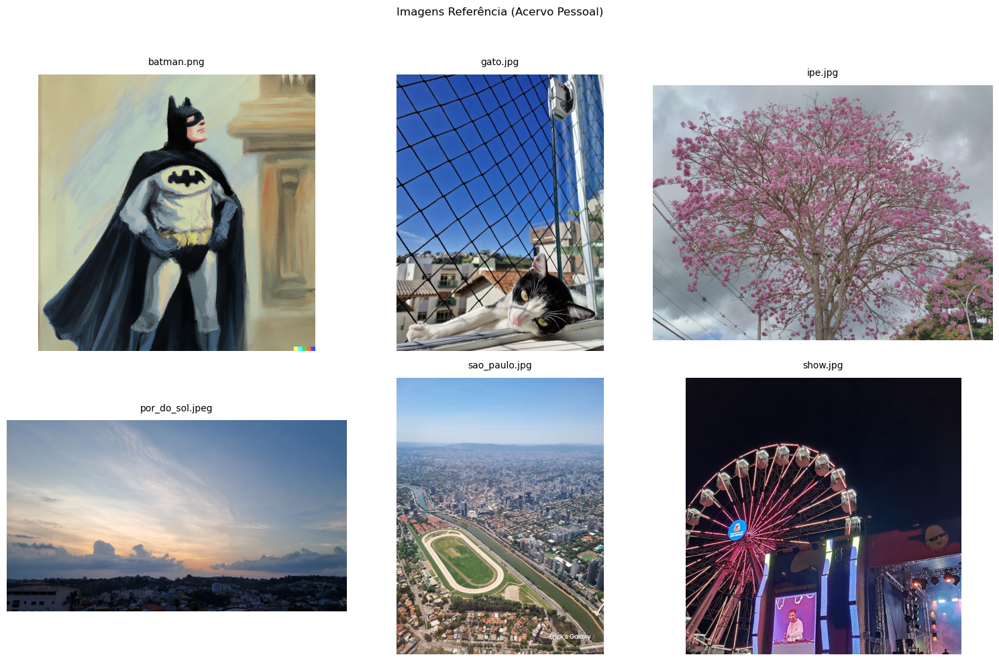

In [ ]:
display_image_grid(IMAGES_PATH, 'Imagens Referência (Acervo Pessoal)')

#### Aplicação da QuadTree

A implementação da QuadTree desenvolvida para este trabalho conta com dois parâmetros especiais em seu construtor, que são opcionais e responsáveis por ditar o nível de compactação da imagem alvo, sendo eles `threshold` e ` min_quad_size`, respectivamente. O primeiro determina o desvio padrão máximo de tolerância da cor para que um quadrante não seja quadripartido, já o segundo determina o número mínimo de pixels que devem estar presente em um quadrante (considerando largura e altura, o primeiro que atingir o limite). Um aspecto interessante dessa implementação é que o não fornecimento do parâmetro `threshold` torna a compressão um processo de blocos fixos como veteremos a seguir:

In [ ]:
# Abaixo são definidos alguns parâmetros que serão aplicados no processo de compressão de todas as
# imagens referência.

parameters = [
    {'threshold': 5, 'min_quad_size': 5},
    {'threshold': 10, 'min_quad_size': 4},
    {'threshold': 20, 'min_quad_size': 3},
    {'threshold': 30, 'min_quad_size': 2},
    # A partir daqui se dá a compactação por blocos fixos
    {'min_quad_size': 8},
    {'min_quad_size': 16},
    {'min_quad_size': 32},
    {'min_quad_size': 64},
]

In [ ]:
# Criação das QuadTrees para cada par (img_ref, params)
compressed_images = {}

for ref in images_ref:
    compressed_images[ref] = []
    for params in parameters:
        compressed_images[ref].append(QuadTree(image=images_ref[ref], **params))


In [ ]:
def calculate_psnr(original_image, compressed_image) -> float:
    # Peak Signal-to-Noise Ratio Metric
    # Reference: https://www.mathworks.com/help/vision/ref/psnr.html
    original_r, original_g, original_b = cv2.split(original_image)
    compressed_r, compressed_g, compressed_b = cv2.split(compressed_image)

    mse_r = np.mean((original_r - compressed_r) ** 2)
    mse_g = np.mean((original_g - compressed_g) ** 2)
    mse_b = np.mean((original_b - compressed_b) ** 2)

    max_pixel_value = 255.0
    psnr_r = 10 * np.log10((max_pixel_value ** 2) / mse_r) if mse_r != 0 else float('inf')
    psnr_g = 10 * np.log10((max_pixel_value ** 2) / mse_g) if mse_g != 0 else float('inf')
    psnr_b = 10 * np.log10((max_pixel_value ** 2) / mse_b) if mse_b != 0 else float('inf')

    psnr_mean = (psnr_r + psnr_g + psnr_b) / 3

    return psnr_mean


In [ ]:
def calc_image_metrics(original_image: np.ndarray, comp_image: QuadTree) -> tuple:
    before_pixels = original_image.shape[0] * original_image.shape[1]
    after_pixels = len(comp_image.get_children())

    compress_ratio = before_pixels / after_pixels
    psnr = calculate_psnr(original_image, comp_image.get_compressed_image())

    if psnr < 30:
        psnr_status = 'Compressão de baixa qualidade'
    elif psnr < 40:
        psnr_status = 'Compressão de qualidade moderada'
    elif psnr < 50:
        psnr_status = 'Compressão de qualidade moderada'
    else:
        psnr_status = 'Compressão de qualidade excelente'

    print(f'\tImage Dimensions: {original_image[0].shape}')
    print(f'\tPixel Information (Before Compression): {before_pixels}')
    print(f'\tPixel Information (After Compression): {after_pixels}')
    print(
        f'\tCompression Ration (in number of "pixels"): {compress_ratio:.2f}x')
    print(f'\tPSNR: {psnr:.2f} dB ({psnr_status})')



    return compress_ratio, psnr

> Compressions for "batman" image:
 
> USING THRESHOLD BLOCKS COMPRESSION <
1º - Using params {'threshold': 5, 'min_quad_size': 5}
	Image Dimensions: (1024, 3)
	Pixel Information (Before Compression): 1048576
	Pixel Information (After Compression): 8614
	Compression Ration (in number of "pixels"): 121.73x
	PSNR: 33.61 dB (Compressão de qualidade moderada)


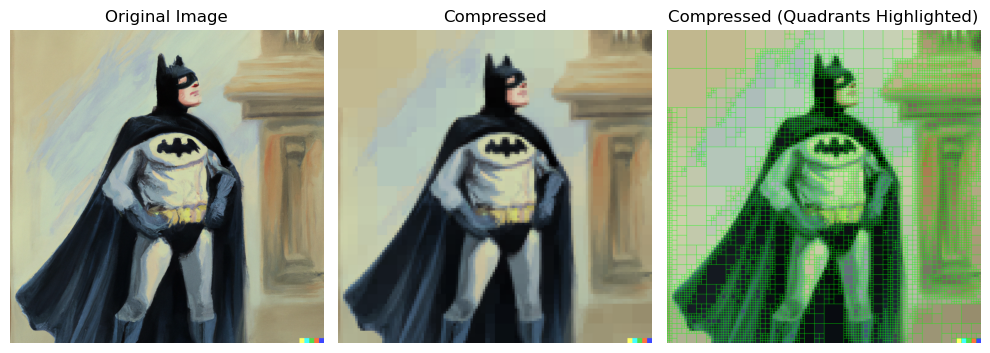

2º - Using params {'threshold': 10, 'min_quad_size': 4}
	Image Dimensions: (1024, 3)
	Pixel Information (Before Compression): 1048576
	Pixel Information (After Compression): 4963
	Compression Ration (in number of "pixels"): 211.28x
	PSNR: 32.40 dB (Compressão de qualidade moderada)


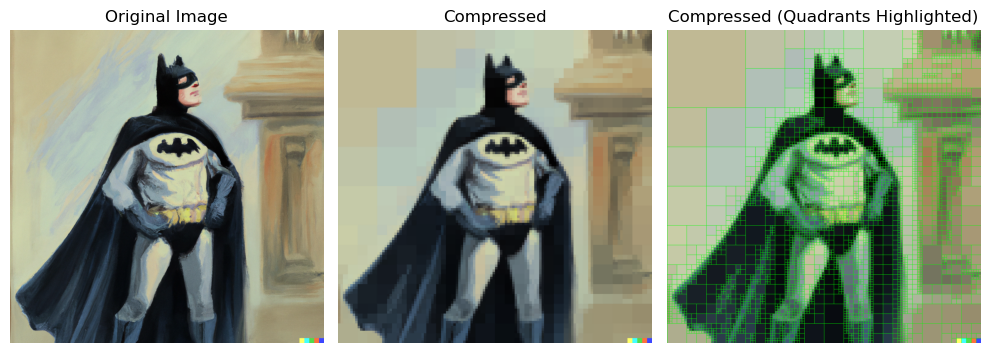

3º - Using params {'threshold': 20, 'min_quad_size': 3}
	Image Dimensions: (1024, 3)
	Pixel Information (Before Compression): 1048576
	Pixel Information (After Compression): 5068
	Compression Ration (in number of "pixels"): 206.90x
	PSNR: 30.99 dB (Compressão de qualidade moderada)


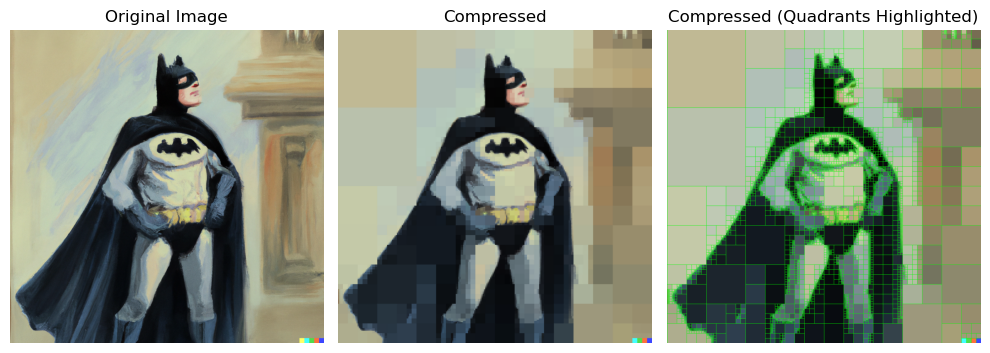

4º - Using params {'threshold': 30, 'min_quad_size': 2}
	Image Dimensions: (1024, 3)
	Pixel Information (Before Compression): 1048576
	Pixel Information (After Compression): 2785
	Compression Ration (in number of "pixels"): 376.51x
	PSNR: 30.08 dB (Compressão de qualidade moderada)


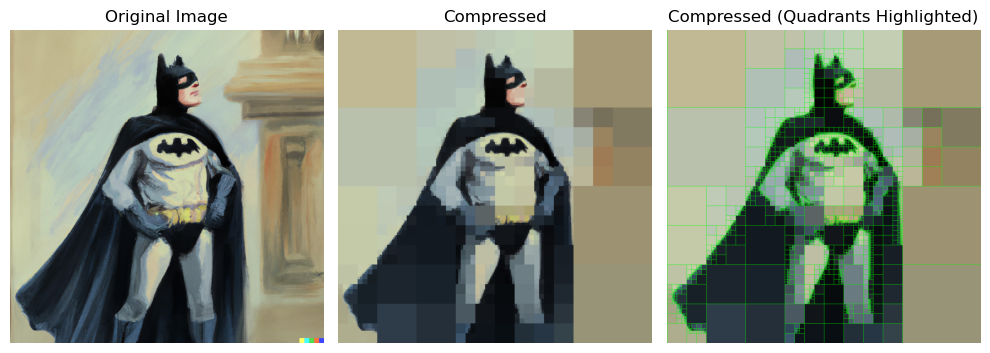

 
> USING FIXED BLOCKS COMPRESSION <
5º - Using params {'min_quad_size': 8}
	Image Dimensions: (1024, 3)
	Pixel Information (Before Compression): 1048576
	Pixel Information (After Compression): 4096
	Compression Ration (in number of "pixels"): 256.00x
	PSNR: 32.53 dB (Compressão de qualidade moderada)


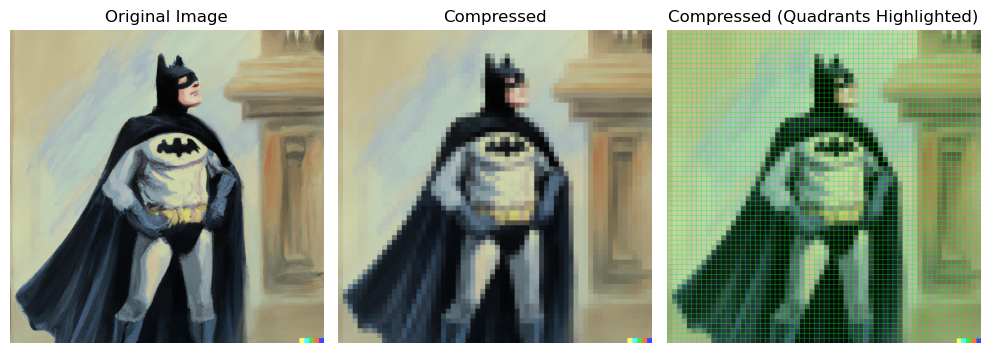

6º - Using params {'min_quad_size': 16}
	Image Dimensions: (1024, 3)
	Pixel Information (Before Compression): 1048576
	Pixel Information (After Compression): 1024
	Compression Ration (in number of "pixels"): 1024.00x
	PSNR: 30.93 dB (Compressão de qualidade moderada)


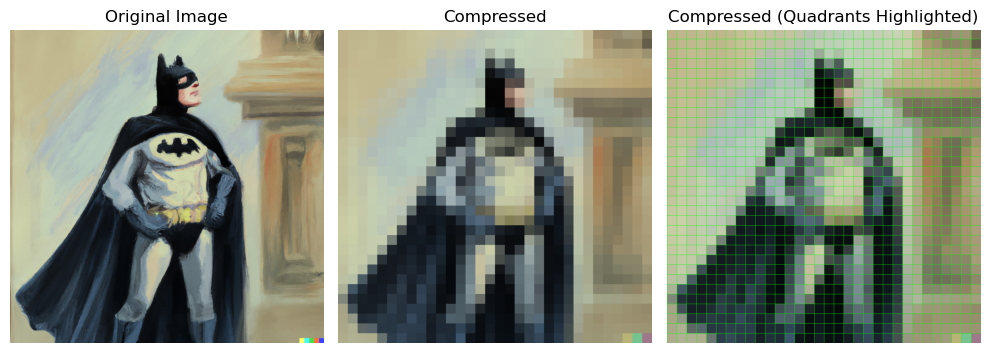

7º - Using params {'min_quad_size': 32}
	Image Dimensions: (1024, 3)
	Pixel Information (Before Compression): 1048576
	Pixel Information (After Compression): 256
	Compression Ration (in number of "pixels"): 4096.00x
	PSNR: 29.71 dB (Compressão de baixa qualidade)


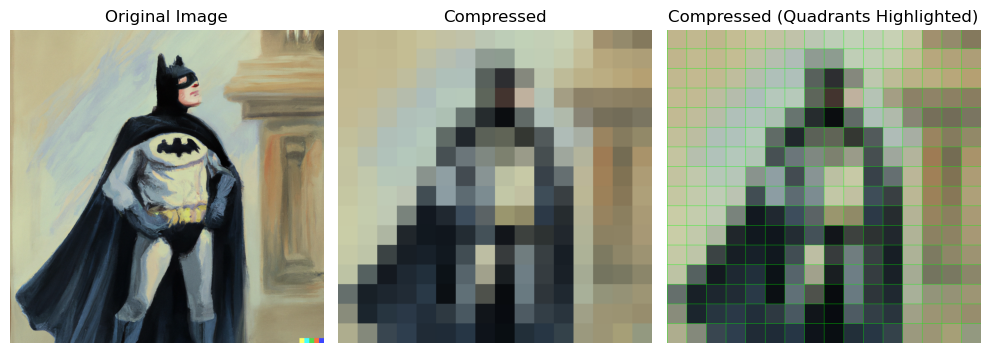

8º - Using params {'min_quad_size': 64}
	Image Dimensions: (1024, 3)
	Pixel Information (Before Compression): 1048576
	Pixel Information (After Compression): 64
	Compression Ration (in number of "pixels"): 16384.00x
	PSNR: 28.73 dB (Compressão de baixa qualidade)


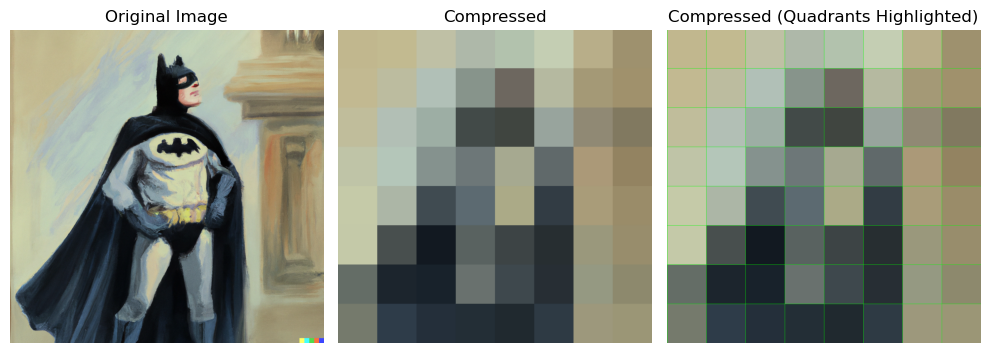


----------------------------------

> Compressions for "gato" image:
 
> USING THRESHOLD BLOCKS COMPRESSION <
1º - Using params {'threshold': 5, 'min_quad_size': 5}
	Image Dimensions: (689, 3)
	Pixel Information (Before Compression): 633191
	Pixel Information (After Compression): 3757
	Compression Ration (in number of "pixels"): 168.54x
	PSNR: 29.85 dB (Compressão de baixa qualidade)


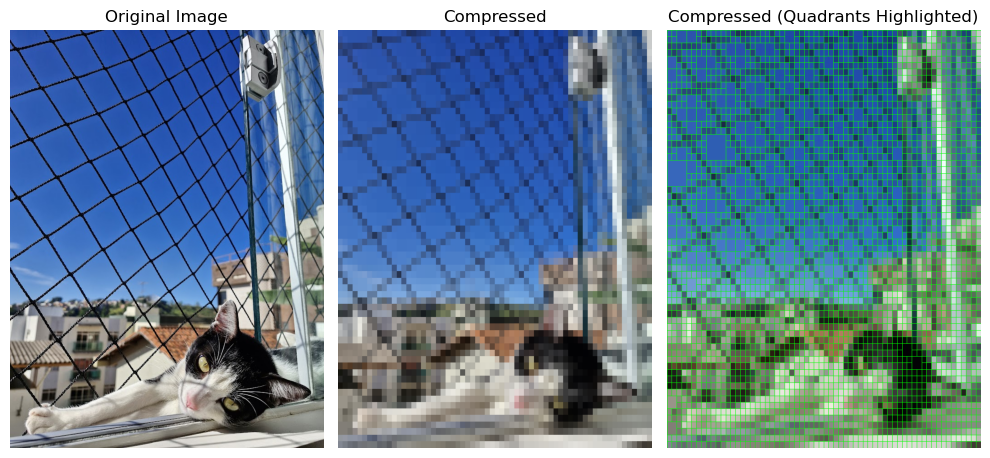

2º - Using params {'threshold': 10, 'min_quad_size': 4}
	Image Dimensions: (689, 3)
	Pixel Information (Before Compression): 633191
	Pixel Information (After Compression): 11992
	Compression Ration (in number of "pixels"): 52.80x
	PSNR: 30.85 dB (Compressão de qualidade moderada)


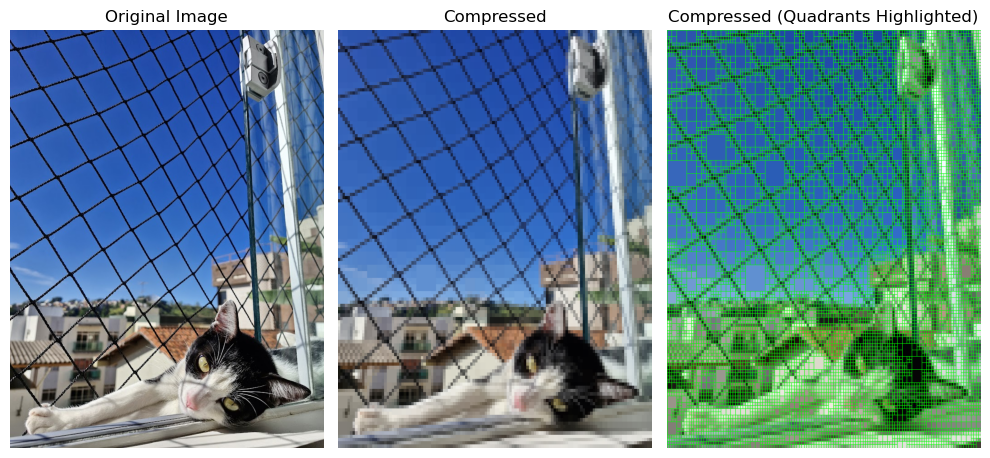

3º - Using params {'threshold': 20, 'min_quad_size': 3}
	Image Dimensions: (689, 3)
	Pixel Information (Before Compression): 633191
	Pixel Information (After Compression): 9703
	Compression Ration (in number of "pixels"): 65.26x
	PSNR: 30.55 dB (Compressão de qualidade moderada)


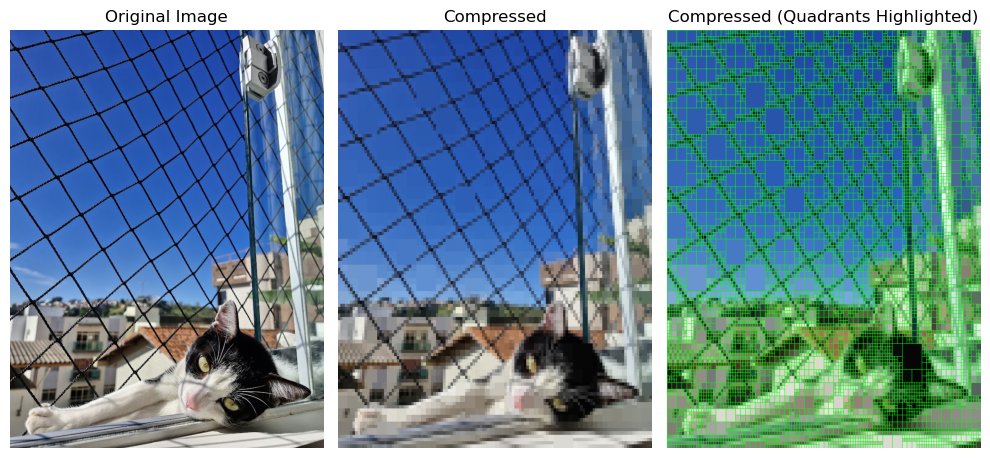

4º - Using params {'threshold': 30, 'min_quad_size': 2}
	Image Dimensions: (689, 3)
	Pixel Information (Before Compression): 633191
	Pixel Information (After Compression): 9073
	Compression Ration (in number of "pixels"): 69.79x
	PSNR: 29.67 dB (Compressão de baixa qualidade)


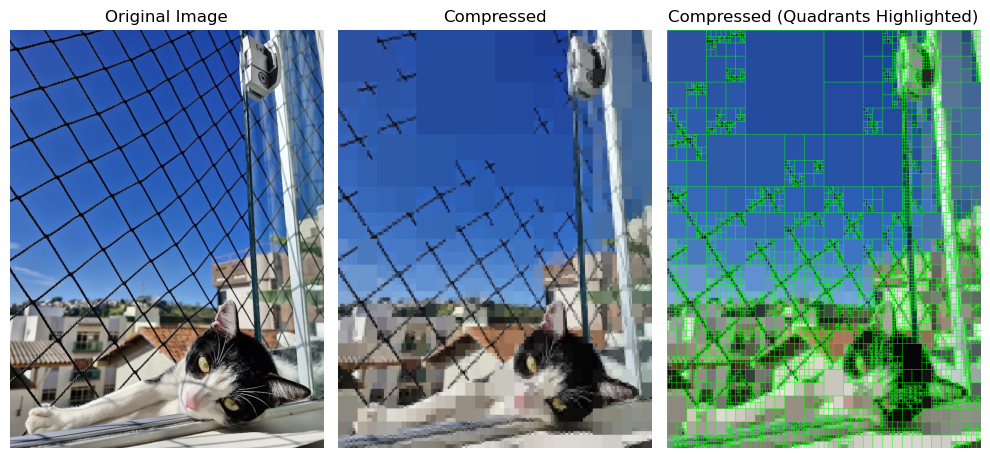

 
> USING FIXED BLOCKS COMPRESSION <
5º - Using params {'min_quad_size': 8}
	Image Dimensions: (689, 3)
	Pixel Information (Before Compression): 633191
	Pixel Information (After Compression): 4096
	Compression Ration (in number of "pixels"): 154.59x
	PSNR: 29.87 dB (Compressão de baixa qualidade)


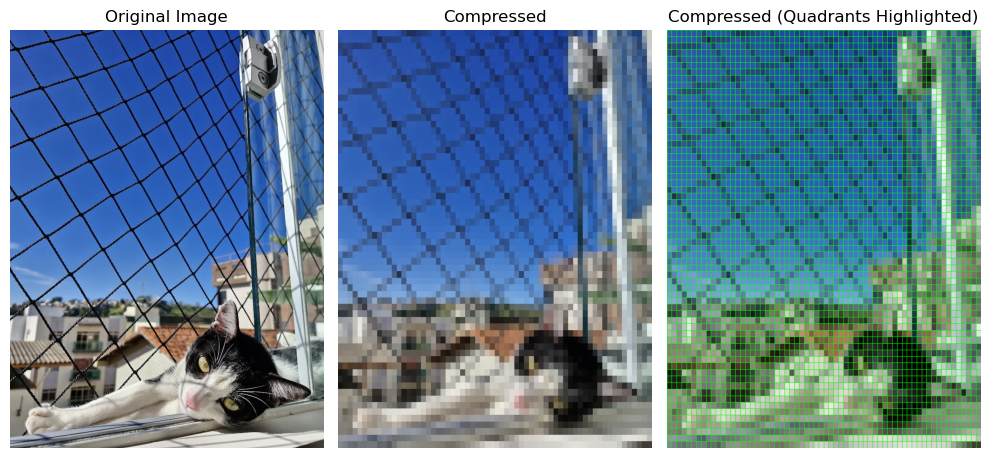

6º - Using params {'min_quad_size': 16}
	Image Dimensions: (689, 3)
	Pixel Information (Before Compression): 633191
	Pixel Information (After Compression): 1024
	Compression Ration (in number of "pixels"): 618.35x
	PSNR: 29.03 dB (Compressão de baixa qualidade)


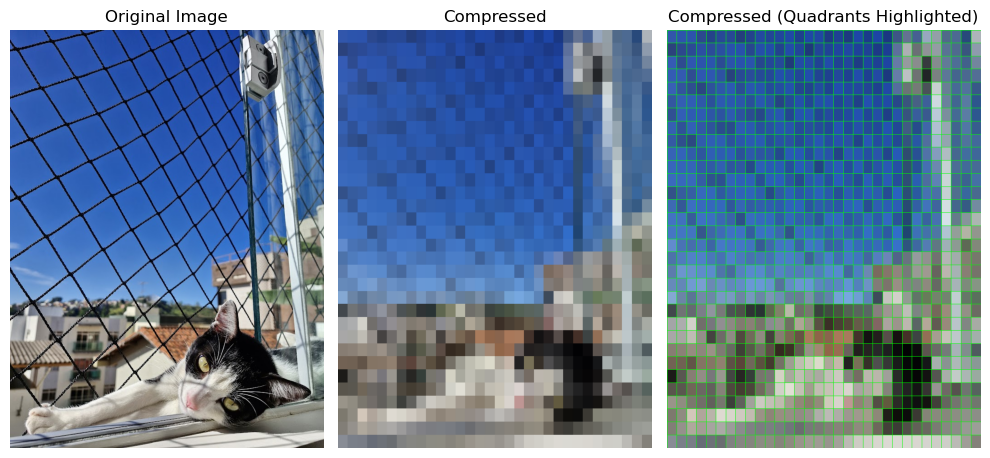

7º - Using params {'min_quad_size': 32}
	Image Dimensions: (689, 3)
	Pixel Information (Before Compression): 633191
	Pixel Information (After Compression): 256
	Compression Ration (in number of "pixels"): 2473.40x
	PSNR: 28.59 dB (Compressão de baixa qualidade)


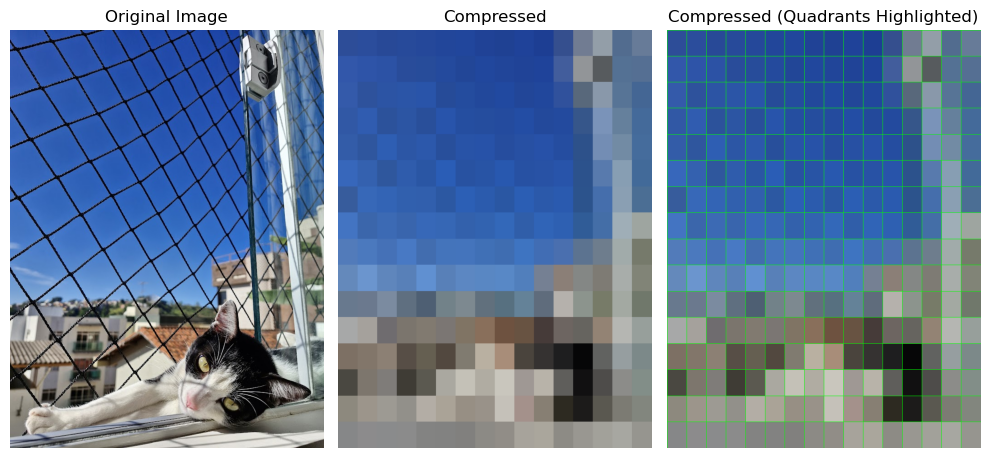

8º - Using params {'min_quad_size': 64}
	Image Dimensions: (689, 3)
	Pixel Information (Before Compression): 633191
	Pixel Information (After Compression): 64
	Compression Ration (in number of "pixels"): 9893.61x
	PSNR: 28.46 dB (Compressão de baixa qualidade)


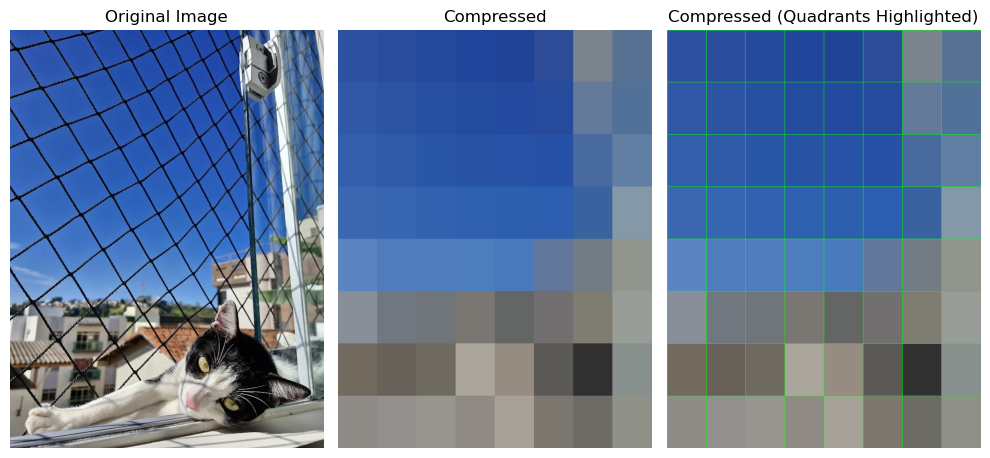


----------------------------------

> Compressions for "ipe" image:
 
> USING THRESHOLD BLOCKS COMPRESSION <
1º - Using params {'threshold': 5, 'min_quad_size': 5}
	Image Dimensions: (4608, 3)
	Pixel Information (Before Compression): 15925248
	Pixel Information (After Compression): 187888
	Compression Ration (in number of "pixels"): 84.76x
	PSNR: 30.26 dB (Compressão de qualidade moderada)


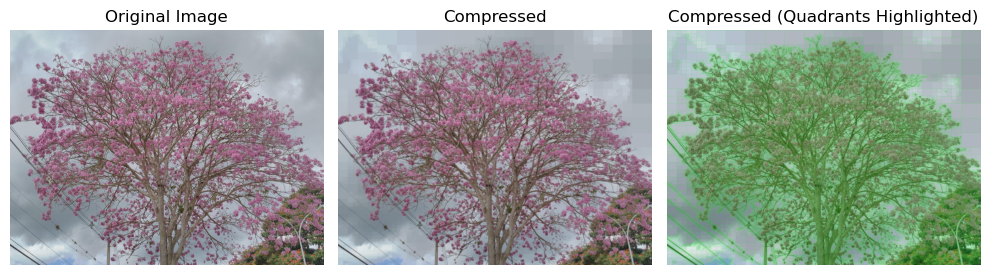

2º - Using params {'threshold': 10, 'min_quad_size': 4}
	Image Dimensions: (4608, 3)
	Pixel Information (Before Compression): 15925248
	Pixel Information (After Compression): 178468
	Compression Ration (in number of "pixels"): 89.23x
	PSNR: 30.03 dB (Compressão de qualidade moderada)


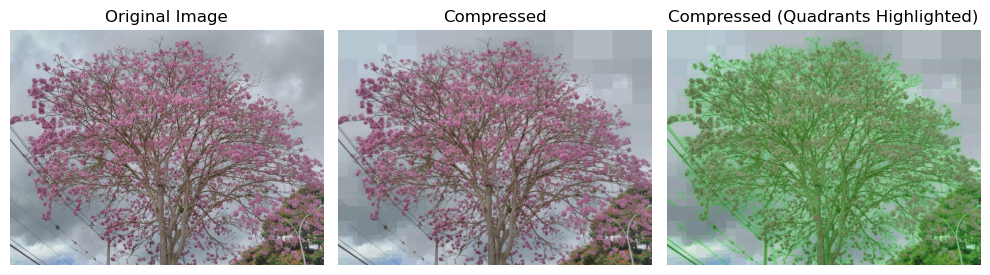

3º - Using params {'threshold': 20, 'min_quad_size': 3}
	Image Dimensions: (4608, 3)
	Pixel Information (Before Compression): 15925248
	Pixel Information (After Compression): 141238
	Compression Ration (in number of "pixels"): 112.75x
	PSNR: 29.52 dB (Compressão de baixa qualidade)


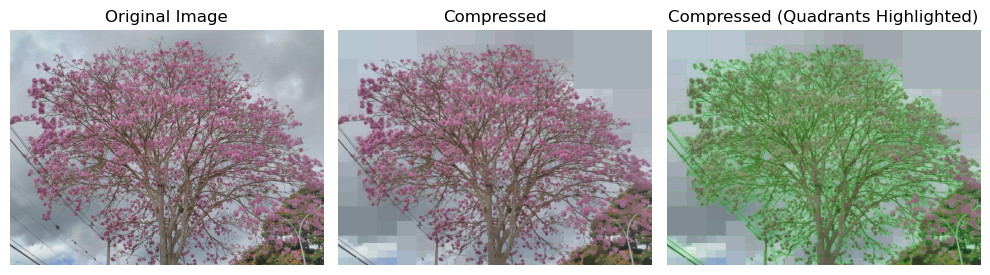

4º - Using params {'threshold': 30, 'min_quad_size': 2}
	Image Dimensions: (4608, 3)
	Pixel Information (Before Compression): 15925248
	Pixel Information (After Compression): 193006
	Compression Ration (in number of "pixels"): 82.51x
	PSNR: 29.00 dB (Compressão de baixa qualidade)


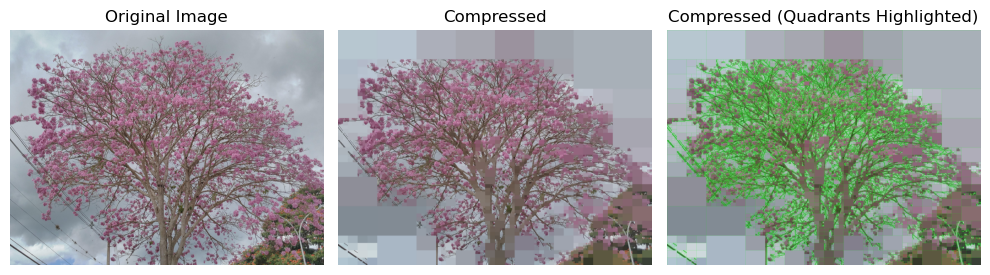

 
> USING FIXED BLOCKS COMPRESSION <
5º - Using params {'min_quad_size': 8}
	Image Dimensions: (4608, 3)
	Pixel Information (Before Compression): 15925248
	Pixel Information (After Compression): 65536
	Compression Ration (in number of "pixels"): 243.00x
	PSNR: 29.87 dB (Compressão de baixa qualidade)


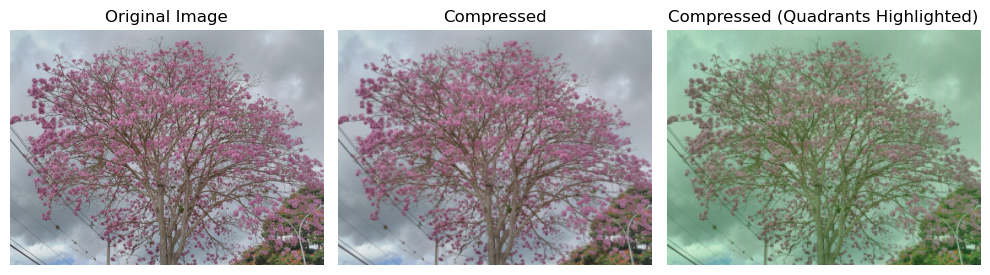

6º - Using params {'min_quad_size': 16}
	Image Dimensions: (4608, 3)
	Pixel Information (Before Compression): 15925248
	Pixel Information (After Compression): 16384
	Compression Ration (in number of "pixels"): 972.00x
	PSNR: 29.50 dB (Compressão de baixa qualidade)


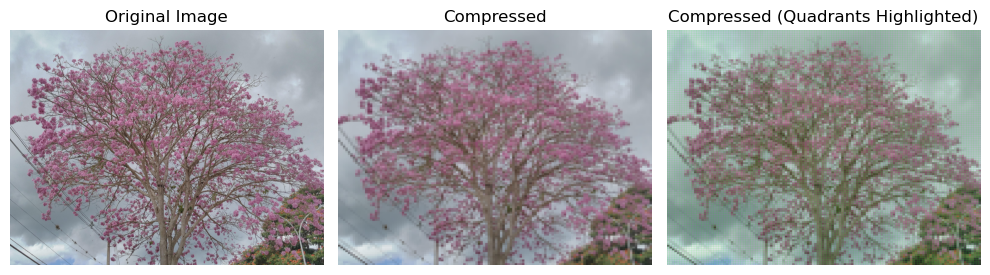

7º - Using params {'min_quad_size': 32}
	Image Dimensions: (4608, 3)
	Pixel Information (Before Compression): 15925248
	Pixel Information (After Compression): 4096
	Compression Ration (in number of "pixels"): 3888.00x
	PSNR: 29.18 dB (Compressão de baixa qualidade)


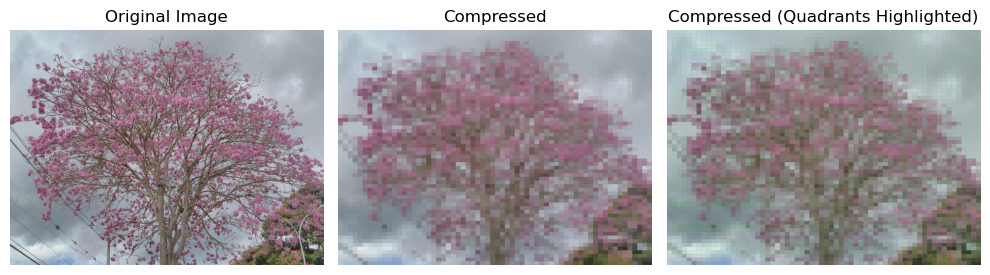

8º - Using params {'min_quad_size': 64}
	Image Dimensions: (4608, 3)
	Pixel Information (Before Compression): 15925248
	Pixel Information (After Compression): 1024
	Compression Ration (in number of "pixels"): 15552.00x
	PSNR: 28.90 dB (Compressão de baixa qualidade)


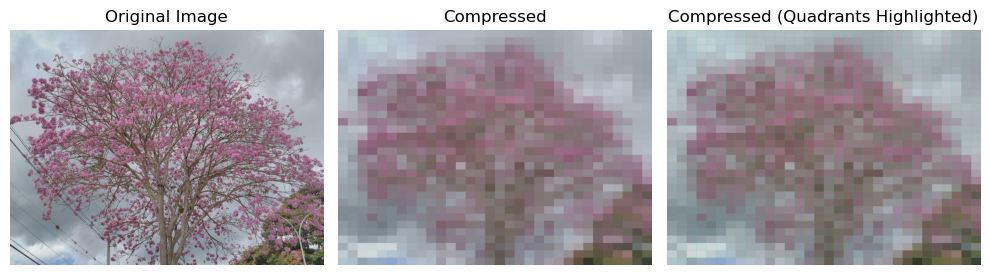


----------------------------------

> Compressions for "por_do_sol" image:
 
> USING THRESHOLD BLOCKS COMPRESSION <
1º - Using params {'threshold': 5, 'min_quad_size': 5}
	Image Dimensions: (1278, 3)
	Pixel Information (Before Compression): 918882
	Pixel Information (After Compression): 2503
	Compression Ration (in number of "pixels"): 367.11x
	PSNR: 34.69 dB (Compressão de qualidade moderada)


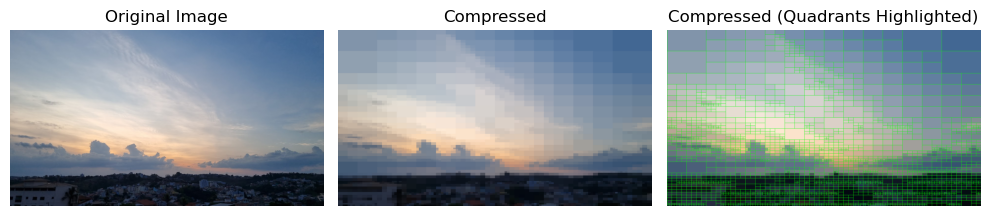

2º - Using params {'threshold': 10, 'min_quad_size': 4}
	Image Dimensions: (1278, 3)
	Pixel Information (Before Compression): 918882
	Pixel Information (After Compression): 2494
	Compression Ration (in number of "pixels"): 368.44x
	PSNR: 32.26 dB (Compressão de qualidade moderada)


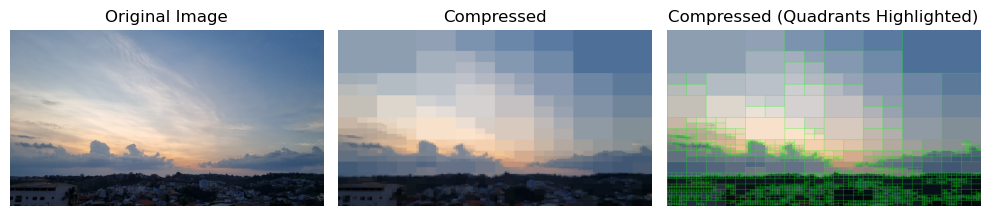

3º - Using params {'threshold': 20, 'min_quad_size': 3}
	Image Dimensions: (1278, 3)
	Pixel Information (Before Compression): 918882
	Pixel Information (After Compression): 532
	Compression Ration (in number of "pixels"): 1727.22x
	PSNR: 29.96 dB (Compressão de baixa qualidade)


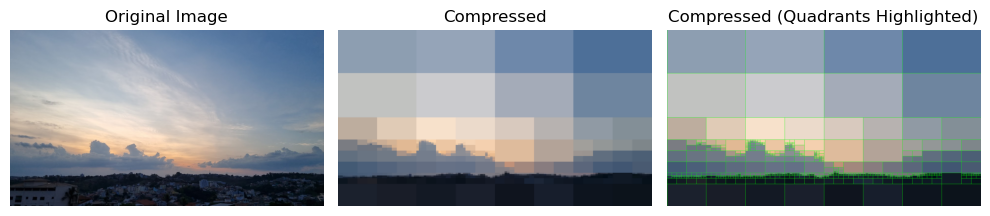

4º - Using params {'threshold': 30, 'min_quad_size': 2}
	Image Dimensions: (1278, 3)
	Pixel Information (Before Compression): 918882
	Pixel Information (After Compression): 331
	Compression Ration (in number of "pixels"): 2776.08x
	PSNR: 28.84 dB (Compressão de baixa qualidade)


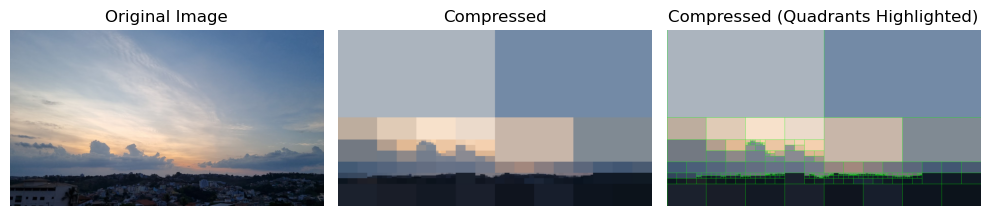

 
> USING FIXED BLOCKS COMPRESSION <
5º - Using params {'min_quad_size': 8}
	Image Dimensions: (1278, 3)
	Pixel Information (Before Compression): 918882
	Pixel Information (After Compression): 4096
	Compression Ration (in number of "pixels"): 224.34x
	PSNR: 35.59 dB (Compressão de qualidade moderada)


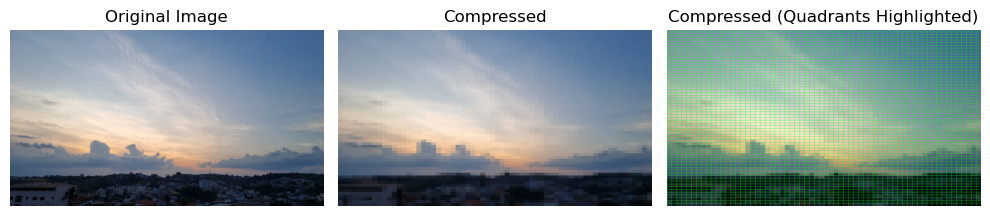

6º - Using params {'min_quad_size': 16}
	Image Dimensions: (1278, 3)
	Pixel Information (Before Compression): 918882
	Pixel Information (After Compression): 1024
	Compression Ration (in number of "pixels"): 897.35x
	PSNR: 33.76 dB (Compressão de qualidade moderada)


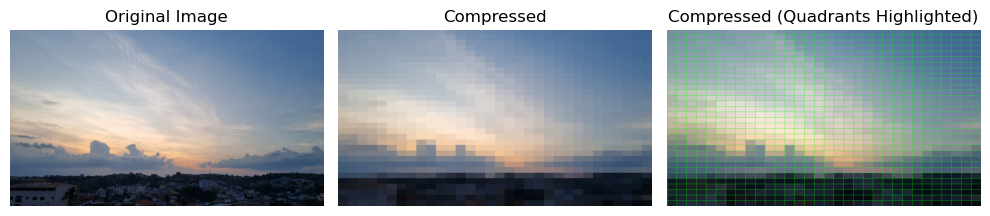

7º - Using params {'min_quad_size': 32}
	Image Dimensions: (1278, 3)
	Pixel Information (Before Compression): 918882
	Pixel Information (After Compression): 256
	Compression Ration (in number of "pixels"): 3589.38x
	PSNR: 32.04 dB (Compressão de qualidade moderada)


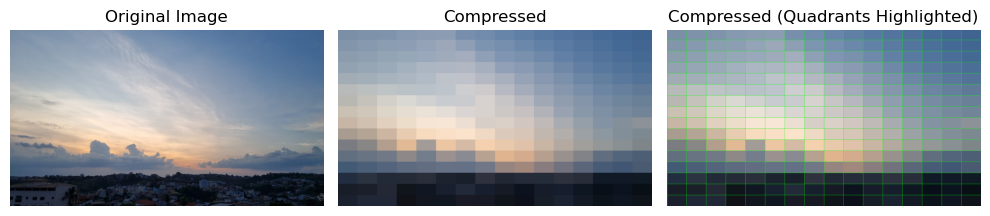

8º - Using params {'min_quad_size': 64}
	Image Dimensions: (1278, 3)
	Pixel Information (Before Compression): 918882
	Pixel Information (After Compression): 64
	Compression Ration (in number of "pixels"): 14357.53x
	PSNR: 30.07 dB (Compressão de qualidade moderada)


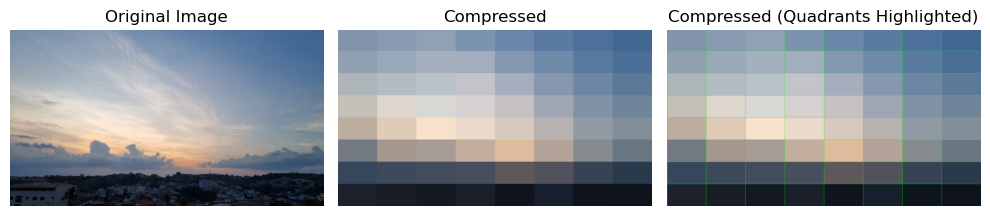


----------------------------------

> Compressions for "sao_paulo" image:
 
> USING THRESHOLD BLOCKS COMPRESSION <
1º - Using params {'threshold': 5, 'min_quad_size': 5}
	Image Dimensions: (689, 3)
	Pixel Information (Before Compression): 633191
	Pixel Information (After Compression): 3328
	Compression Ration (in number of "pixels"): 190.26x
	PSNR: 29.53 dB (Compressão de baixa qualidade)


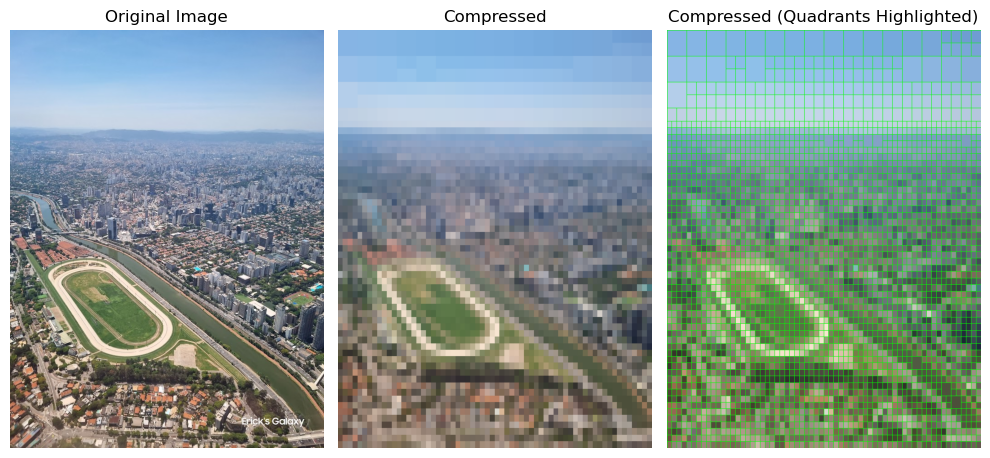

2º - Using params {'threshold': 10, 'min_quad_size': 4}
	Image Dimensions: (689, 3)
	Pixel Information (Before Compression): 633191
	Pixel Information (After Compression): 11542
	Compression Ration (in number of "pixels"): 54.86x
	PSNR: 29.52 dB (Compressão de baixa qualidade)


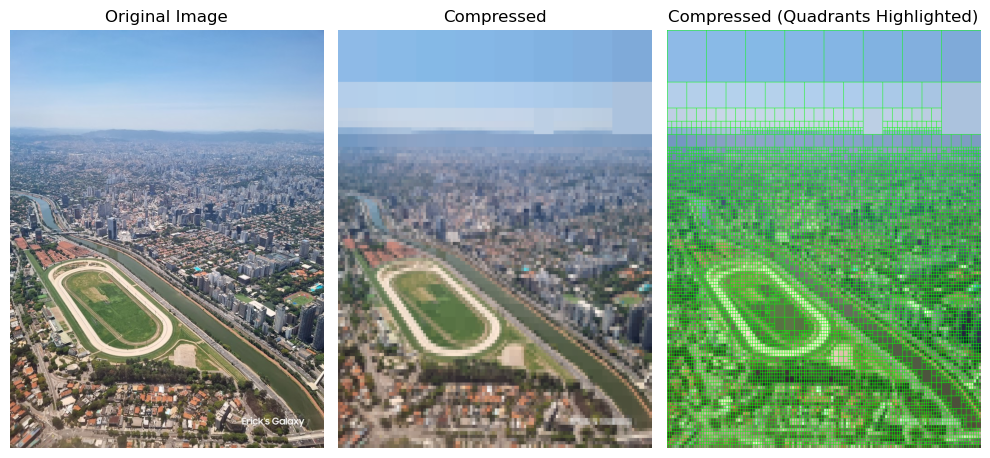

3º - Using params {'threshold': 20, 'min_quad_size': 3}
	Image Dimensions: (689, 3)
	Pixel Information (Before Compression): 633191
	Pixel Information (After Compression): 9778
	Compression Ration (in number of "pixels"): 64.76x
	PSNR: 28.93 dB (Compressão de baixa qualidade)


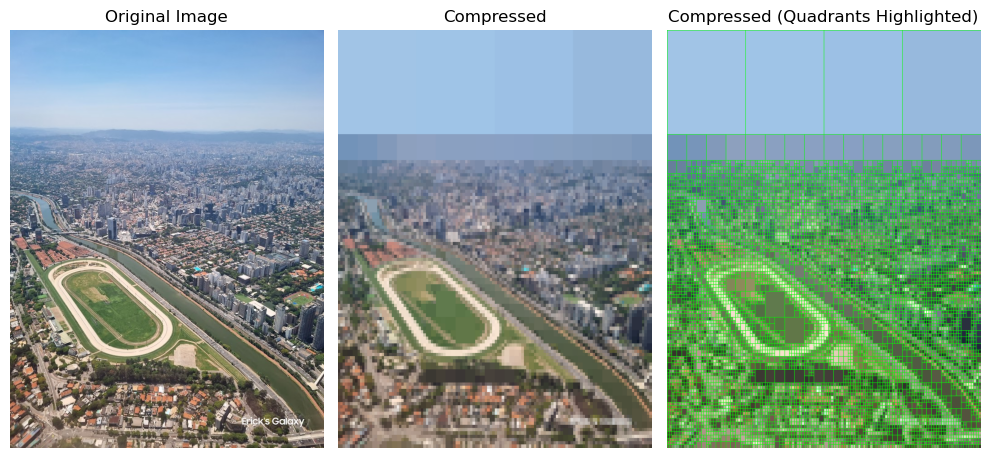

4º - Using params {'threshold': 30, 'min_quad_size': 2}
	Image Dimensions: (689, 3)
	Pixel Information (Before Compression): 633191
	Pixel Information (After Compression): 13312
	Compression Ration (in number of "pixels"): 47.57x
	PSNR: 28.81 dB (Compressão de baixa qualidade)


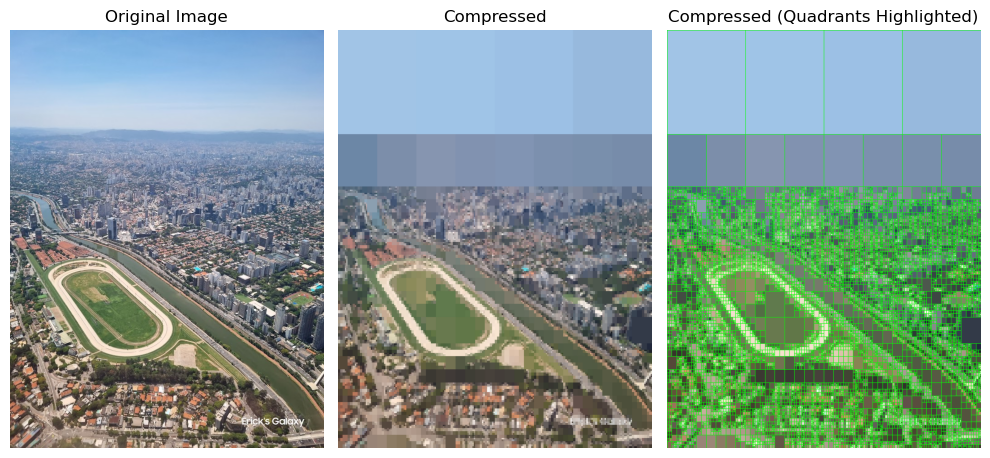

 
> USING FIXED BLOCKS COMPRESSION <
5º - Using params {'min_quad_size': 8}
	Image Dimensions: (689, 3)
	Pixel Information (Before Compression): 633191
	Pixel Information (After Compression): 4096
	Compression Ration (in number of "pixels"): 154.59x
	PSNR: 29.66 dB (Compressão de baixa qualidade)


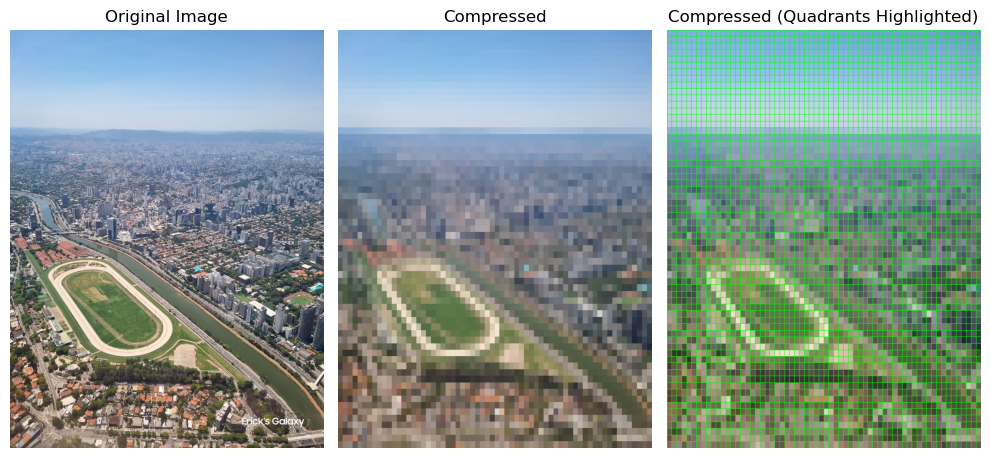

6º - Using params {'min_quad_size': 16}
	Image Dimensions: (689, 3)
	Pixel Information (Before Compression): 633191
	Pixel Information (After Compression): 1024
	Compression Ration (in number of "pixels"): 618.35x
	PSNR: 29.26 dB (Compressão de baixa qualidade)


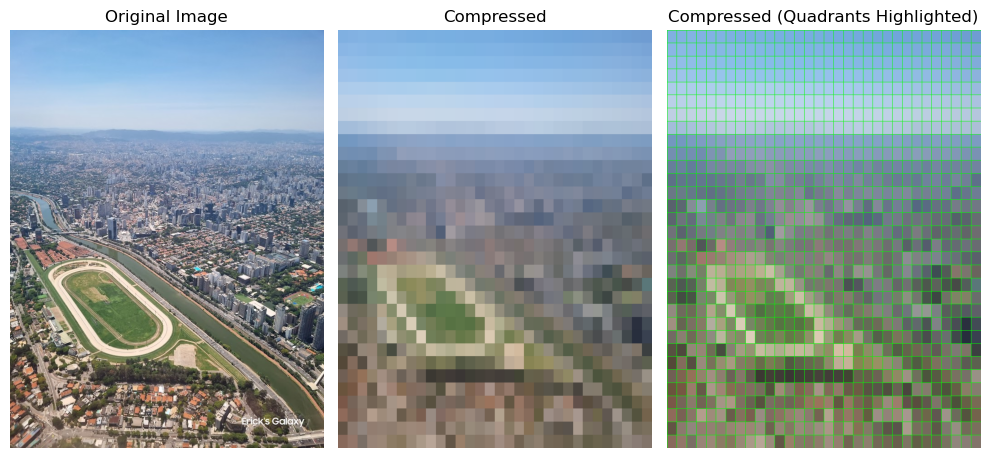

7º - Using params {'min_quad_size': 32}
	Image Dimensions: (689, 3)
	Pixel Information (Before Compression): 633191
	Pixel Information (After Compression): 256
	Compression Ration (in number of "pixels"): 2473.40x
	PSNR: 28.88 dB (Compressão de baixa qualidade)


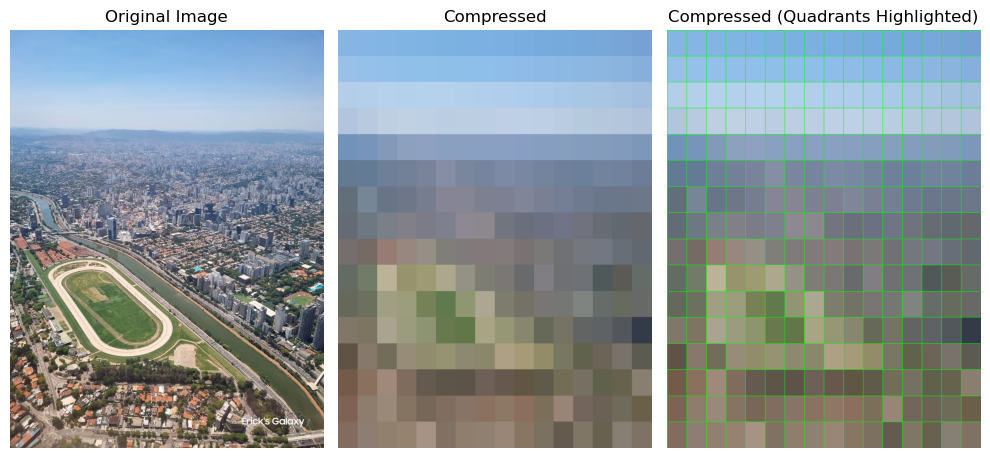

8º - Using params {'min_quad_size': 64}
	Image Dimensions: (689, 3)
	Pixel Information (Before Compression): 633191
	Pixel Information (After Compression): 64
	Compression Ration (in number of "pixels"): 9893.61x
	PSNR: 28.50 dB (Compressão de baixa qualidade)


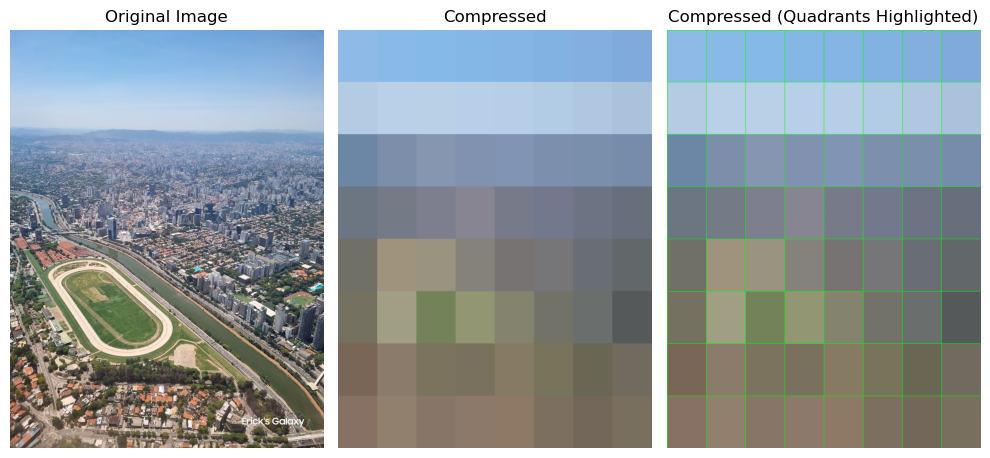


----------------------------------

> Compressions for "show" image:
 
> USING THRESHOLD BLOCKS COMPRESSION <
1º - Using params {'threshold': 5, 'min_quad_size': 5}
	Image Dimensions: (689, 3)
	Pixel Information (Before Compression): 476788
	Pixel Information (After Compression): 2479
	Compression Ration (in number of "pixels"): 192.33x
	PSNR: 31.09 dB (Compressão de qualidade moderada)


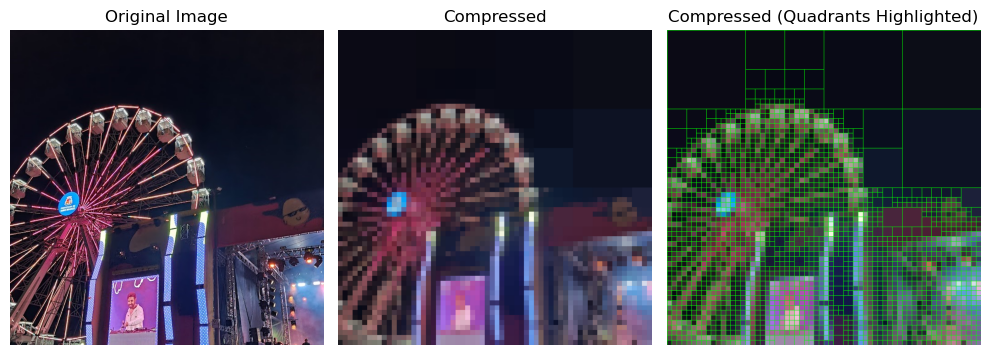

2º - Using params {'threshold': 10, 'min_quad_size': 4}
	Image Dimensions: (689, 3)
	Pixel Information (Before Compression): 476788
	Pixel Information (After Compression): 8194
	Compression Ration (in number of "pixels"): 58.19x
	PSNR: 31.62 dB (Compressão de qualidade moderada)


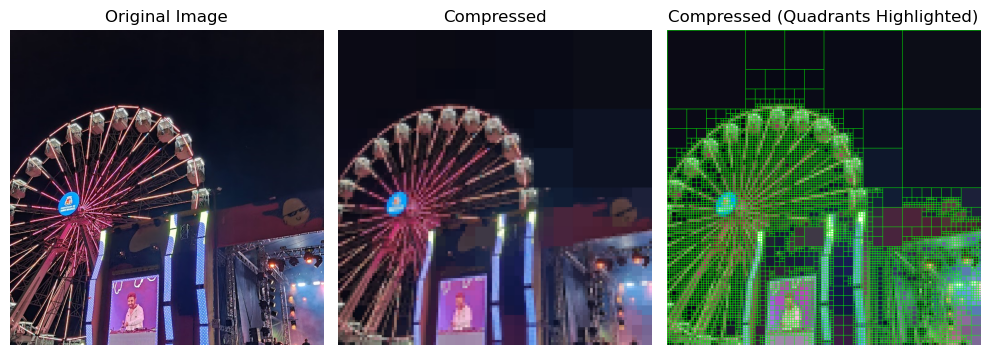

3º - Using params {'threshold': 20, 'min_quad_size': 3}
	Image Dimensions: (689, 3)
	Pixel Information (Before Compression): 476788
	Pixel Information (After Compression): 6667
	Compression Ration (in number of "pixels"): 71.51x
	PSNR: 31.25 dB (Compressão de qualidade moderada)


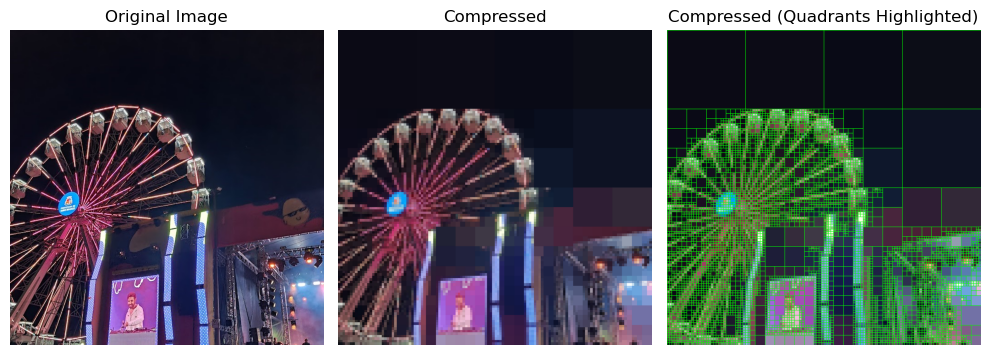

4º - Using params {'threshold': 30, 'min_quad_size': 2}
	Image Dimensions: (689, 3)
	Pixel Information (Before Compression): 476788
	Pixel Information (After Compression): 6640
	Compression Ration (in number of "pixels"): 71.81x
	PSNR: 30.12 dB (Compressão de qualidade moderada)


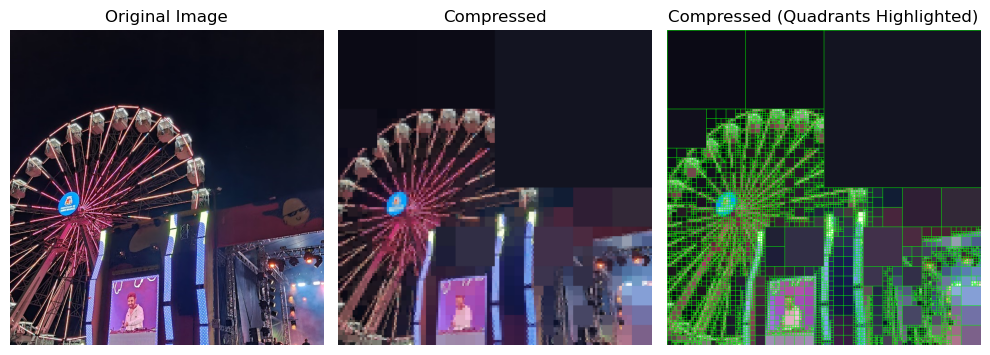

 
> USING FIXED BLOCKS COMPRESSION <
5º - Using params {'min_quad_size': 8}
	Image Dimensions: (689, 3)
	Pixel Information (Before Compression): 476788
	Pixel Information (After Compression): 4096
	Compression Ration (in number of "pixels"): 116.40x
	PSNR: 31.25 dB (Compressão de qualidade moderada)


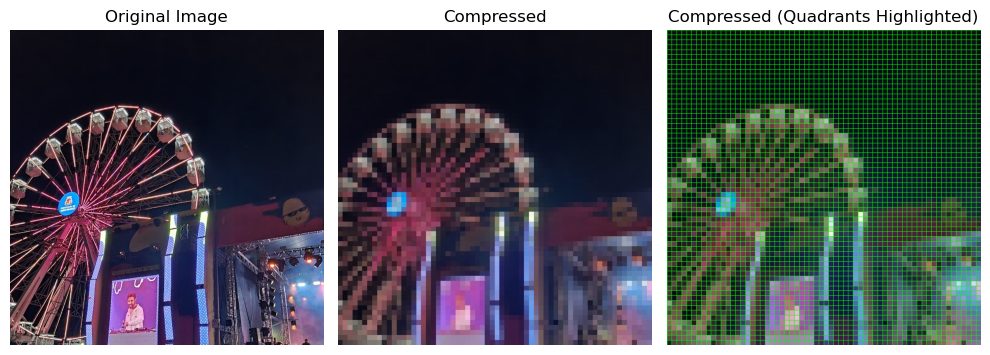

6º - Using params {'min_quad_size': 16}
	Image Dimensions: (689, 3)
	Pixel Information (Before Compression): 476788
	Pixel Information (After Compression): 1024
	Compression Ration (in number of "pixels"): 465.61x
	PSNR: 30.70 dB (Compressão de qualidade moderada)


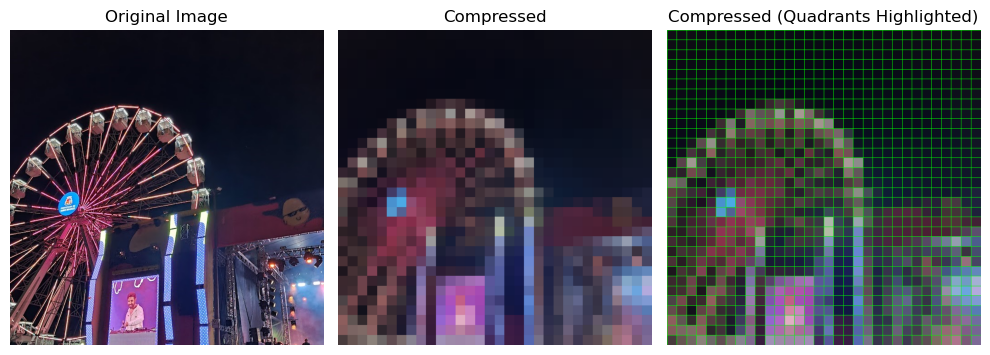

7º - Using params {'min_quad_size': 32}
	Image Dimensions: (689, 3)
	Pixel Information (Before Compression): 476788
	Pixel Information (After Compression): 256
	Compression Ration (in number of "pixels"): 1862.45x
	PSNR: 30.08 dB (Compressão de qualidade moderada)


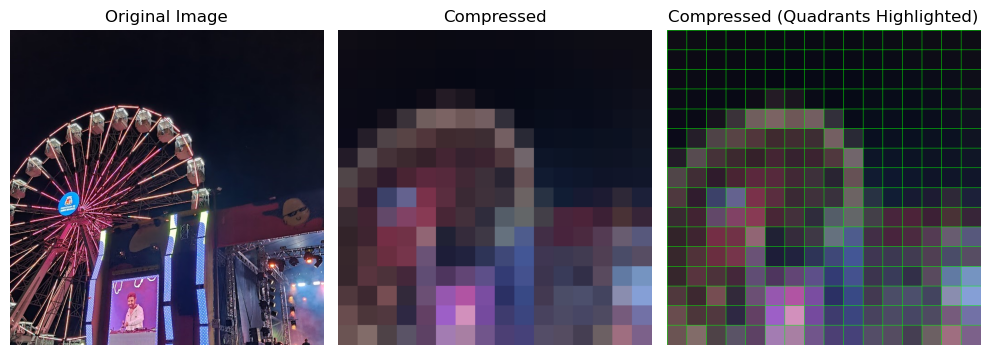

8º - Using params {'min_quad_size': 64}
	Image Dimensions: (689, 3)
	Pixel Information (Before Compression): 476788
	Pixel Information (After Compression): 64
	Compression Ration (in number of "pixels"): 7449.81x
	PSNR: 29.81 dB (Compressão de baixa qualidade)


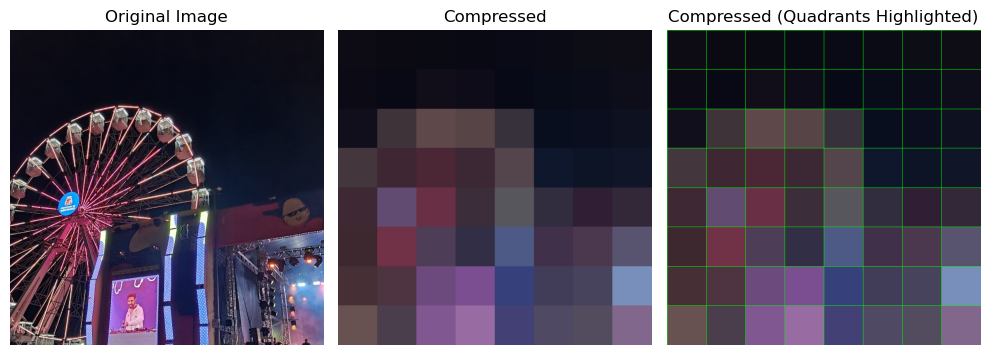


----------------------------------



In [ ]:
stats_for_plot = []

for name in compressed_images:
    print(f'> Compressions for "{name}" image:')
    print(' \n> USING THRESHOLD BLOCKS COMPRESSION <')
    for i, comp in enumerate(compressed_images[name]):
        row = {'name': name}
        if i == 4:
            print(' \n> USING FIXED BLOCKS COMPRESSION <')
        print(f'{i+1}º - Using params {parameters[i]}')

        images_to_show = [images_ref[name],
                          compressed_images[name][i].get_compressed_image(),
                          compressed_images[name][i].get_compressed_image(
                              show_quadrants=True, highlight_color=(0, 255, 0))
                          ]

        cmp_ratio, psnr = calc_image_metrics(original_image=images_ref[name], comp_image=compressed_images[name][i])

        row['compression_ratio'] = cmp_ratio
        row['psnr'] = psnr
        row.update(parameters[i])
        stats_for_plot.append(row)

        fig, axes = plt.subplots(1, 3, figsize=(10, 15))
        captions = ['Original Image', 'Compressed',
                    'Compressed (Quadrants Highlighted)']

        for i, r in enumerate(images_to_show):
            axes[i].imshow(r)
            axes[i].set_title(captions[i])
            axes[i].axis('off')

        plt.tight_layout()
        plt.show()
    print('\n----------------------------------\n')

##### Avaliação Descritiva dos Resultados

In [ ]:
stats_for_plot = pd.DataFrame(stats_for_plot)

stats_fixed_blocks = stats_for_plot[stats_for_plot['threshold'].isna()].drop(columns=['threshold'])
stats_dynamic_blocks = stats_for_plot[~stats_for_plot['threshold'].isna()]


display('Compressão de Blocos Fixos', stats_fixed_blocks.describe())
display('Compressão de Blocos Dinâmicos', stats_dynamic_blocks.describe())

'Compressão de Blocos Fixos'

,compression_ratio,psnr,min_quad_size
count,24.000000,24.000000,24.000000
mean,4069.074097,30.204785,30.000000
std,5253.681119,1.761172,21.908902
min,116.403320,28.464832,8.000000
25%,413.209961,29.000857,14.000000
50%,1443.226562,29.756730,24.000000
75%,4934.453125,30.756154,40.000000
max,16384.000000,35.594477,64.000000


'Compressão de Blocos Dinâmicos'

,compression_ratio,psnr,threshold,min_quad_size
count,24.000000,24.000000,24.000000,24.00000
mean,318.007964,30.559209,16.250000,3.50000
std,623.756244,1.497034,9.807938,1.14208
min,47.565430,28.805526,5.000000,2.00000
25%,68.655680,29.529660,8.750000,2.75000
50%,100.993885,30.096544,15.000000,3.50000
75%,207.995672,31.126229,22.500000,4.25000
max,2776.078550,34.689145,30.000000,5.00000


In [ ]:
def plot_compression_vs_psnr(df: pd.DataFrame, title_complement: str) -> None:
    plt.figure(figsize=(10, 6))
    sns.scatterplot(data=df,
                        x='compression_ratio',
                        y='psnr',
                        hue='name',
                        style='name',
                        palette='viridis',
                        s=100
                    )
    plt.title(f'Compression Ratio vs PSNR {title_complement}')
    plt.xlabel('Compression Ratio')
    plt.ylabel('PSNR')
    plt.legend(title='Image Name')
    plt.show()

    params = {
        'compression_ratio_mean': ('compression_ratio', 'mean'),
        'compression_ratio_median': ('compression_ratio', 'median'),
        'compression_ratio_std': ('compression_ratio', 'std'),
    }

    if 'psnr' in df.columns:
        params.update({
            'psnr_mean': ('psnr', 'mean'),
            'psnr_median': ('psnr', 'median'),
            'psnr_std': ('psnr', 'std')
        })

    print(df.groupby('name').agg(**params)
)

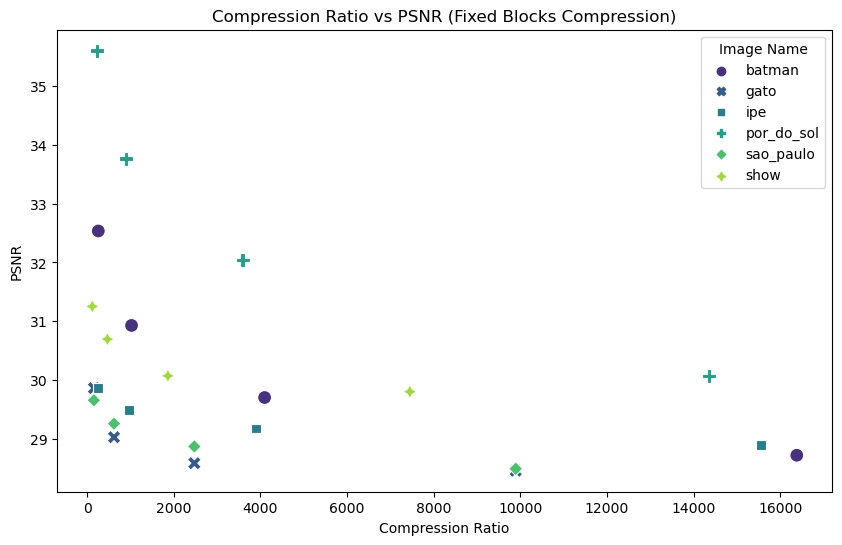

            compression_ratio_mean  compression_ratio_median  \
name                                                           
batman                 5440.000000               2560.000000   
gato                   3284.987488               1545.876465   
ipe                    5163.750000               2430.000000   
por_do_sol             4767.149048               2243.364258   
sao_paulo              3284.987488               1545.876465   
show                   2473.570557               1164.033203   

            compression_ratio_std  psnr_mean  psnr_median  psnr_std  
name                                                                 
batman                7482.254206  30.475184    30.319290  1.642501  
gato                  4518.219016  28.989578    28.813104  0.633876  
ipe                   7102.295984  29.362108    29.337963  0.416624  
por_do_sol            6556.805333  32.868250    32.902299  2.361289  
sao_paulo             4518.219016  29.075024    29.070181  0.500394

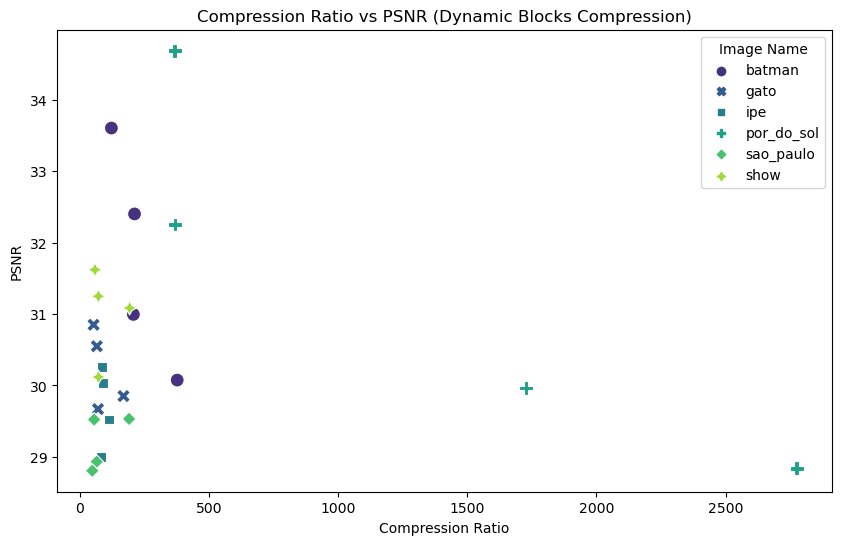

            compression_ratio_mean  compression_ratio_median  \
name                                                           
batman                  229.104430                209.090002   
gato                     89.095796                 67.522867   
ipe                      92.314676                 86.996167   
por_do_sol             1309.712417               1047.829427   
sao_paulo                89.360894                 59.808214   
show                     98.459570                 71.660023   

            compression_ratio_std  psnr_mean  psnr_median  psnr_std  
name                                                                 
batman                 106.564691  31.769756    31.698795  1.553892  
gato                    53.445147  30.230047    30.200271  0.561243  
ipe                     13.910115  29.702981    29.776269  0.562411  
por_do_sol            1168.908050  31.436547    31.109373  2.592915  
sao_paulo               67.635134  29.197667    29.226689  0.383703

In [ ]:
plot_compression_vs_psnr(stats_fixed_blocks, '(Fixed Blocks Compression)')
plot_compression_vs_psnr(stats_dynamic_blocks, '(Dynamic Blocks Compression)')

Acima, encontram-se dispostos de forma qualitativa e quantitativa os resultados da aplicação da estrutura de dados QuadTree sobre as imagens de referência, juntamente com a aplicação de um subconjunto de parâmetros viáveis à todas as imagens. Com isso, foi possível verificar que a estrutura permite alcançar compressões tanto de blocos dinâmicos (com blocos de diferentes tamanhos), quanto a já tradicional compressão de blocos fixos. Além disso, observou-se que a compressão de blocos dinâmicos permite a obtenção de segmentação de conteúdos detalhados ou de vizinhança de grande contraste nas imagens, de forma que o resultado final poderia ser combinado com outras técnicas de morfologia de imagem para aperfeiçoamento desse resultado, caso fosse o foco desse experimento.

A compressão de blocos fixos foi a que obteve o melhor resultado em `compression_ratio`, cerca de $16300$ x, porém com menor qualidade da informação preservada, uma vez que a mediana do `PSNR` da compressão dinâmica indica, apesar de por pouca diferença nos testes realizados (devido ao número de amostras), que esta possui uma maior probabilidade de retornar resultados melhores. Por fim, os resultados também evidenciam que a variância da `compression_ratio` da compressão dinâmica é consideravelmente menor que a de blocos fixos, o que é possível perceber também nos gráficos de "Compression Ratio VS PSNR", já que os resultados (desconsiderando outliers) não apresentam uma razão maior que $500$ x, indicando um processo mais estável no quesito capacidade de compressão para cenário explorado nos experimentos.

#### Compressão dos Dados

A implementação de QuadTree apresentada neste trabalho conta com um método para exportação do resultado da compressão. Para isso, os quadrantes (nós) folhas são reunidos e suas principais informações, bem como o tamanho da imagem são armazenados em um arquivo de texto batizado com a extensão `.lima`. Esse arquivo pode ser submetido ao método estático `parse_compressed_file` para que a imagem seja reconstruída, uma vez que não há um codec nativo para nossa implementação no sistema operacional. O processo se encontra ilustrado abaixo:

In [ ]:
compressed_images['batman'][0].build_compressed_file(save_path='./', filename='im_batman')

'1024;1024&0;0;128;128;193,183,142&128;0;256;128;194,186,144&0;128;128;256;194,185,145&128;128;192;192;193,185,146&192;128;224;160;193,186,148&224;128;240;144;194,186,148&240;128;248;136;195,187,149&248;128;256;136;194,193,161&240;136;248;144;193,190,156&248;136;256;144;191,194,167&224;144;240;160;192,189,156&240;144;256;160;192,193,164&192;160;224;192;190,189,160&224;160;256;192;190,192,164&128;192;144;208;194,186,144&144;192;152;200;193,186,147&152;192;160;200;190,186,155&144;200;152;208;187,186,159&152;200;160;208;184,187,165&128;208;136;216;192,186,148&136;208;144;216;186,186,160&128;216;136;224;186,186,160&136;216;144;224;183,186,165&144;208;160;224;185,187,165&160;192;192;224;188,190,165&128;224;160;256;188,189,162&160;224;192;256;187,188,161&192;192;224;224;188,187,161&224;192;240;208;185,188,167&240;192;248;200;188,189,162&248;192;256;200;182,187,170&240;200;248;208;178,184,173&248;200;256;208;178,185,176&224;208;232;216;185,187,165&232;208;240;216;178,185,174&224;216;232;224;1

The "arr_img" type is "<class 'numpy.ndarray'>"


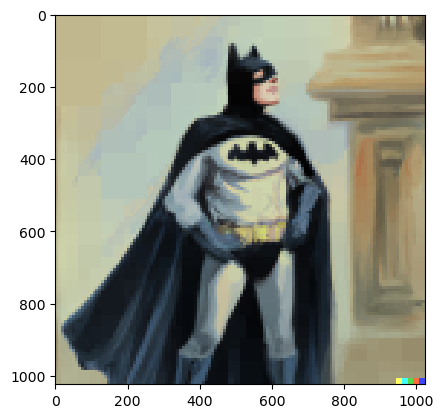

In [ ]:
arr_image = QuadTree.parse_compressed_file(file_path='./im_batman.lima')

print(f'The "arr_img" type is "{type(arr_image)}"')

plt.imshow(arr_image, interpolation='nearest')
plt.show()

Porém, a implementação guarda um problema, uma vez que para que a imagem possa ser reproduzida, considerando a compressão aplicada neste trabalho, além dos 3 canais de cores (vermelho, verde e azul) é necessário o armazenamento da coordenada (x, y) juntamente com o comprimento e a largura, que determinam o espaço que será colorido com o pixel defido, totalizando sete informações. A depender da dos parâmetros aplicados para a formação da imagem por meio da estrutura pode acarretar em um fenômeno em que a imagem comprimida se torna mais pesada em bytes que a original, já que nos arquivos `.lima` são armazenadas 7 informações e não apenas as cores, além da dimensão original da imagem e separadores em formato de texto usual (ASCII).

Visando contornar o problema acima, buscou-se o desenvolvimento de um método de compressão de texto, a codificação de Huffman, que permitiria a conversão das strings acima para um formato binário capaz de ser armazenado em um formato mais leve. Abaixo são apresentadas a comparação em número de caracteres antes e após a codificação de Huffman. Para cada uma das QuadTrees contendo as imagens comprimidas.

In [ ]:
text_compression = []

for name in compressed_images:
    print(f'For {name}:')
    for i, cmp_img in enumerate(compressed_images[name]):
        print('\t> Using params:', parameters[i])
        data = cmp_img.build_compressed_file(
            save_path='./', filename=f'{name}_{i}')
        original_size = len(data)*8
        print(
            f'\t\tOriginal data ({len(data)} characters): {data[:50]}...\n\t\tApproximate file size: {original_size} bits\n')
        enc, root = HuffmanEncoding().encoding(text=data)
        print(
            f'\t\tHuffman data ({len(enc)} characters): {enc[:50]}...\n\t\tApproximate file size: {len(enc)} bits\n')

For batman:
	> Using params: {'threshold': 5, 'min_quad_size': 5}
		Original data (228923 characters): 1024;1024&0;0;128;128;193,183,142&128;0;256;128;19...
		Approximate file size: 1831384 bits

		Frequence by char: {'1': 25637, '0': 16593, '2': 19843, '4': 20306, ';': 34457, '&': 8614, '8': 20696, '9': 11659, '3': 11096, ',': 17228, '5': 11264, '6': 20469, '7': 11061}
		Huffman data (834108 characters): 01110011110111110101110011110111111010100110110011...
		Approximate file size: 834108 bits

	> Using params: {'threshold': 10, 'min_quad_size': 4}
		Original data (131509 characters): 1024;1024&0;0;256;256;192,185,148&256;0;384;128;19...
		Approximate file size: 1052072 bits

		Frequence by char: {'1': 13650, '0': 9500, '2': 11090, '4': 12567, ';': 19853, '&': 4963, '5': 7116, '6': 12368, '9': 6282, ',': 9926, '8': 11261, '3': 6557, '7': 6376}
		Huffman data (478843 characters): 01110011101001101011100111010011110010011011001101...
		Approximate file size: 478843 bits

	> Using params

A partir da saída acima, é possível constatar que tamanho do arquivo na extensão `.lima` não é dependente do tamanho da imagem original, mas sim dos parâmetros passados à QuadTree e consequentemente o número de quadrantes (nós) filhos produzidos. Além disso, a codificação de Huffman acabou produzindo consideravelmente mais elementos que o texto original devido ao número de elementos no dicionário e a formação de prefixos, porém o arquivo binarizado acaba se tornando bem mais leve na maioria dos casos devido ao seu formato de armazenamento.

#### Conclusão

O presente trabalho permitiu o desenvolvimento de métodos de compressão de imagem e texto, bem como a investigação de seu funcionamento por meio de experimentos e análise de complexidade, explorando a prática de diferentes design de desenvolvimento de algoritmos e permitindo a compreensão de _tradeoffs_ no processo de compressão da informação. Como produto foram desenvolvidas as estruturas de dados `QuadTree` e `HuffmanEncoding`, que podem ser escaladas e incrementadas de modo a, por exemplo, permitir uma compressão do resultado de forma mais eficiente no quesito espaço.
